# Projecting the Impact of Climate Change on Global Ecoregion Distributions 
Andrew Burton, March 2021

In [1]:
import math
import pickle
import sklearn
import datetime
import imblearn
import itertools
import numpy as np
import xarray as xr
import pandas as pd
import netCDF4 as nc
import seaborn as sns
import geopandas as gpd
from sklearn import metrics,svm
from matplotlib import pyplot as plt
from shapely.geometry import Polygon
import matplotlib.patches as mpatches
from sklearn.decomposition import PCA
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import OneHotEncoder,StandardScaler
from sklearn.model_selection import train_test_split,GridSearchCV
from sklearn.metrics import classification_report,confusion_matrix,r2_score,mean_squared_error,accuracy_score

## Links
### Trainging
Temperature Monthly Mean Records (C):<br>
https://psl.noaa.gov/data/gridded/data.ghcncams.html<br>
Precipitation Monthly Mean Records (cm):<br>
https://psl.noaa.gov/data/gridded/data.cmap.html<br>
Elevation (m):<br>
https://www.usgs.gov/centers/eros/science/usgs-eros-archive-digital-elevation-global-multi-resolution-terrain-elevation?qt-science_center_objects=0#qt-science_center_objects<br>

### Target
Ecoregions:<br>
http://maps.tnc.org/gis_data.html<br> 

### Projections
Temperature and Precipitation (K, mm):<br>
https://gisclimatechange.ucar.edu/gis-climatedata<br>
Sea Level Rise (m):<br>
http://www.climateeconometrics.org/sealevel_rcp/<br>

## Load Data

In [2]:
ecoreg = gpd.read_file('tnc_terr_ecoregions.shp') # meters
airtmp = xr.open_dataset('air.mon.mean.v501.nc')['air']
airmax = xr.open_dataset('Complete_TMAX_LatLong1.nc')
precip = xr.open_dataset('precip.mon.total.v501.nc')['precip']
elevDF = gpd.read_file('GMTED2010_Spatial_Metadata.shp')

In [3]:
sea_rise = pd.DataFrame ({'_20' : [0]*10,
                          '_45' : pd.read_table('tot.ga.ar5.rcp45.dat',sep='\s+')['p-values'].iloc[1:].values,
                          '_85' : pd.read_table('tot.ga.ar5.rcp85.dat',sep='\s+')['p-values'].iloc[1:].values},
                          index = [str(y) for y in range(2010,2101,10) ])
sea_rise['_60'] = (sea_rise._45+sea_rise._85)/2
sea_rise = sea_rise.T

for d in range(10,100,10):
    dif = (sea_rise[str(2000+d+10)] - sea_rise[str(2000+d)])/10
    for y in range(10):       
        sea_rise[str(2000+d+y)] = sea_rise[str(2000+d)]+(y*dif)
        
sea_rise = sea_rise[sorted(sea_rise.columns)]

sea_rise.columns = pd.date_range("2010-01-01", periods=91, freq="Y")

In [5]:
tFiles = [f'tas_all_{i[0][0]}_{i[0][1]}_rcp{i[1]}-180.0_180.0_-90.0_90.0.shp' for i in list(itertools.product(
                    [(2006,2019),(2020,2040),(2041,2061),(2062,2082),(2083,2100)], [26,45,60,85]))]
pFiles = [f'ppt_all_{i[0][0]}_{i[0][1]}_rcp{i[1]}-180.0_180.0_-90.0_90.0.shp' for i in list(itertools.product(
                    [(2006,2019),(2020,2040),(2041,2061),(2062,2082),(2083,2100)], [26,45,60,85]))]

temp_2_6 =  gpd.read_file(tFiles[0]).drop(['GID_LON'],axis=1)
projCoord = temp_2_6.geometry
temp_2_6.drop('geometry',axis=1,inplace=True)
temp_4_5 =  gpd.read_file(tFiles[1]).drop(['GID_LON','geometry'],axis=1)
temp_6_0 =  gpd.read_file(tFiles[2]).drop(['GID_LON','geometry'],axis=1)
temp_8_5 =  gpd.read_file(tFiles[3]).drop(['GID_LON'],axis=1)

prec_2_6 =  gpd.read_file(pFiles[0]).drop(['GID_LON','geometry'],axis=1)
prec_4_5 =  gpd.read_file(pFiles[1]).drop(['GID_LON','geometry'],axis=1)
prec_6_0 =  gpd.read_file(pFiles[2]).drop(['GID_LON','geometry'],axis=1)
prec_8_5 =  gpd.read_file(pFiles[3]).drop(['GID_LON','geometry'],axis=1)

for f in range(4,len(tFiles)-1,4):
    print(f)
    temp_2_6 = temp_2_6.merge(gpd.read_file(tFiles[f+0]).drop(['GID_LON','GID_LAT','geometry'],axis=1),
                              left_index=True,right_index=True)
    temp_4_5 = temp_4_5.merge(gpd.read_file(tFiles[f+1]).drop(['GID_LON','GID_LAT','geometry'],axis=1),
                              left_index=True,right_index=True)
    temp_6_0 = temp_6_0.merge(gpd.read_file(tFiles[f+2]).drop(['GID_LON','GID_LAT','geometry'],axis=1),
                              left_index=True,right_index=True)
    temp_8_5 = temp_8_5.merge(gpd.read_file(tFiles[f+3]).drop(['GID_LON','GID_LAT','geometry'],axis=1),
                              left_index=True,right_index=True)

    prec_2_6 = prec_2_6.merge(gpd.read_file(pFiles[f+0]).drop(['GID_LON','GID_LAT','geometry'],axis=1),
                              left_index=True,right_index=True)
    prec_4_5 = prec_4_5.merge(gpd.read_file(pFiles[f+1]).drop(['GID_LON','GID_LAT','geometry'],axis=1),
                              left_index=True,right_index=True)
    prec_6_0 = prec_6_0.merge(gpd.read_file(pFiles[f+2]).drop(['GID_LON','GID_LAT','geometry'],axis=1),
                              left_index=True,right_index=True)
    prec_8_5 = prec_8_5.merge(gpd.read_file(pFiles[f+3]).drop(['GID_LON','GID_LAT','geometry'],axis=1),
                              left_index=True,right_index=True)

4
8
12
16


In [6]:
temp2001 = gpd.read_file('tas_all_2001_2001_historical-180.0_180.0_-90.0_90.0.shp')
prec2001 = gpd.read_file('ppt_all_2001_2001_historical-180.0_180.0_-90.0_90.0.shp')

## Functions

In [7]:
regions=sorted(ecoreg.WWF_MHTNAM.drop_duplicates())+['New Ocean']
colors = ['darkcyan','khaki','green','blue','teal',
         'olivedrab','yellowgreen','lavender','seagreen',
         'mediumseagreen','greenyellow','seagreen','forestgreen',
         'limegreen','darkgreen','azure','dodgerblue']
ecoCMAP = {r:c for r,c in zip(regions,colors)}

sns.set(style="ticks", context="talk")
plt.style.use("dark_background")

def plotMap(ecoregions,geometry,elevation,ocean,ecoCMAP,year,model,wrong=[]):
    
    fig, ax = plt.subplots(figsize = (30,15))
    ax.set_aspect('equal')
    plot_df = pd.DataFrame({'Ecoregion':ecoregions,'lon':geometry.x,'lat':geometry.y})

    sns.scatterplot(x=ocean.x,y=ocean.y,ax=ax,color='blue',linewidth=0,s=20,marker='8',legend=False)
    sns.scatterplot(data=plot_df,x='lon',y='lat',hue='Ecoregion',palette=ecoCMAP,ax=ax,
                    linewidth=0,s=25,marker='8')
    sns.scatterplot(data=elevation,y='lat',x='lon',hue='elev_avg',palette='Greys', 
                    ax=ax,legend=False,linewidth=0,s=15,marker='8',alpha=0.25)
    
    if len(wrong) != 0:      
        sns.scatterplot(data=wrong,y='lat',x='lon',color='red',ax=ax,legend=False,linewidth=2,s=60,marker='o')

    if model == '':
        plt.title(f'{year} Ecoregion Distribution')
    else:
        plt.title(f'{year} Projected Ecoregion Distribution, {model}')
    ax.set_ylabel('')    
    ax.set_xlabel('')

    ax.legend(loc='lower center', bbox_to_anchor=(0.5, -0.25),title='Ecoregion',ncol=3,frameon=False)
    
    plt.tight_layout()
    plt.show()

In [8]:
def projectScenarios(s1,s2,s3,s4,ecoCMAP,unit):

    eco_iterator = (e for e in ecoCMAP.keys() if e!='New Ocean' and e!= 'Inland Water')

    fig,ax = plt.subplots(5,3,figsize=(15,30),sharex=True)
    time = s1.Date.unique()
    
    if unit == 'Temperature':
        dif = 8
        colors = ['lime','gold','darkorange','orangered']
    else:
        colors = ['turquoise','darkviolet','mediumvioletred','crimson']
        dif = 33
    
    for i in range(5):
        for j in range(3):
            ecoregion = next(eco_iterator)
            s1p = s1[s1.Ecoregion==ecoregion].reset_index()[unit]
            s2p = s2[s2.Ecoregion==ecoregion].reset_index()[unit]
            s3p = s3[s3.Ecoregion==ecoregion].reset_index()[unit]
            s4p = s4[s4.Ecoregion==ecoregion].reset_index()[unit]

            p1 = sns.lineplot(x=time,y=s1p,ax=ax[i][j],color=colors[0])
            p2 = sns.lineplot(x=time,y=s2p,ax=ax[i][j],color=colors[1])
            p3 = sns.lineplot(x=time,y=s3p,ax=ax[i][j],color=colors[2])
            p4 = sns.lineplot(x=time,y=s4p,ax=ax[i][j],color=colors[3])
            
            if j != 0:
                p1.set(ylabel=None)
                
            minimum =  math.floor(min(s1p.min(),s2p.min(),s3p.min(),s4p.min()))
            ax[i][j].set_ylim(minimum-0.5,minimum+dif)
            ax[i][j].set_title(formatTitle(ecoregion))
            
    p1_patch = mpatches.Patch(color=colors[0], label='RCP2.6')
    p2_patch = mpatches.Patch(color=colors[1], label='RCP4.5')
    p3_patch = mpatches.Patch(color=colors[2], label='RCP6.0')
    p4_patch = mpatches.Patch(color=colors[3], label='RCP8.5')
        
    fig.legend(handles=[p1_patch,p2_patch,p3_patch,p4_patch],loc='lower center', 
               bbox_to_anchor=(0.5, -0.03),ncol=5,title='Scenario',frameon=False)

    plt.suptitle(f'Projected {unit} Increase by Ecoregion')
    plt.tight_layout()

In [9]:
def plotMonthAvg(df,unit):   

    fig, ax = plt.subplots(figsize = (30,15))
    plot = sns.lineplot(data=df,x='Month',y=unit,hue='Ecoregion',palette='gist_rainbow',ax=ax,linewidth=5)
    ax.set_title(f"Mean Monthly {unit} by Ecoregion")
    ax.legend(loc='lower center', bbox_to_anchor=(0.5, -0.25),title='Ecoregion',ncol=3,frameon=False)
    plot.set(xlabel=None)
    plt.show()

In [10]:
def projectScenarios2(projections,ecoCMAP):

    eco_iterator = (e for e in ecoCMAP.keys() if e!= 'Inland Water')

    fig,ax = plt.subplots(5,3,figsize=(15,30),sharex=True)
    time = projections[0].columns
    
    colors = ['lime','gold','darkorange','orangered']
    for i in range(5):
        for j in range(3):
            ecoregion = next(eco_iterator)
            s1p = projections[0].loc[ecoregion]/100000
            s2p = projections[1].loc[ecoregion]/100000
            s3p = projections[2].loc[ecoregion]/100000
            s4p = projections[3].loc[ecoregion]/100000

            p1 = sns.lineplot(x=time,y=s1p,ax=ax[i][j],color=colors[0])
            p2 = sns.lineplot(x=time,y=s2p,ax=ax[i][j],color=colors[1])
            p3 = sns.lineplot(x=time,y=s3p,ax=ax[i][j],color=colors[2])
            p4 = sns.lineplot(x=time,y=s4p,ax=ax[i][j],color=colors[3])
        
            if j == 0:
                p1.set(ylabel='Area (100,000 $km^{2}$')
            else:
                p1.set(ylabel=None)
   
            ax[i][j].ticklabel_format(style='plain')
            ax[i][j].set_title(formatTitle(ecoregion))
            
    p1_patch = mpatches.Patch(color=colors[0], label='RCP2.6')
    p2_patch = mpatches.Patch(color=colors[1], label='RCP4.5')
    p3_patch = mpatches.Patch(color=colors[2], label='RCP6.0')
    p4_patch = mpatches.Patch(color=colors[3], label='RCP8.5')
        
    fig.legend(handles=[p1_patch,p2_patch,p3_patch,p4_patch],loc='lower center', 
               bbox_to_anchor=(0.5, -0.03),ncol=5,title='Scenario',frameon=False)

    plt.suptitle(f'Projected Ecoregion Area')
    plt.tight_layout()

In [11]:
def plotEcoMonthAvg(df,unit,ecoCMAP):

    eco_iterator = (e for e in ecoCMAP.keys() if e!='New Ocean' and e!= 'Inland Water')
    
    fig,ax = plt.subplots(5,3,figsize=(15,30),sharey=True)
    
    for i in range(5):
        for j in range(3):
            e = next(eco_iterator)
            plot = sns.lineplot(data=df[df.Ecoregion==e],x='Month',y=unit,hue='Latitude',
                                 palette='winter',ax=ax[i][j])
            
            ax[i][j].set_title(formatTitle(e))
            plot.legend_.remove()
            plot.set(xlabel=None)
            
            ax[i][j].set_xticks(['January','','','April','','','July','','','October','',''])
    handles, labels = fig.axes[-1].get_legend_handles_labels()
    fig.legend(handles, labels, loc='lower center', bbox_to_anchor=(0.5, -0.03),ncol=5,
               title='Latitude',frameon=False)
    
    plt.suptitle(f'Mean Monthly {unit} by Latitude, 1990-2100')
    plt.tight_layout()

In [12]:
def formatTitle(string):

    if len(string) > 28:
        string = string.split(' ')
        if (l:=len(string))%2==0:
            w = len(string)//2
        else:
            w = len(string)//2 + 1
        return ' '.join(string[:w]) + '\n' + ' '.join(string[w:])
    return(string)

In [13]:
def getFeatures(xr,cName,cID,y=2001):

    for m in range(1,13):
        if m < 10:
            m = f'0{m}'

        t = pd.DataFrame(xr.loc[f'{y}-{m}-01T00:00:00.000000000'].to_dataframe().values)

        if m == '01':
            df = pd.DataFrame({'id':cID, f'{cName}{m}':t[1]})
        else:
            df[f'{cName}{m}'] = t[1]  
    
    df[f'{cName}Avg'] = df.drop('id', axis=1).mean(axis=1)
    return df 

In [14]:
def getNearest(A,i,rowNAs,colNAs,lat,lon):

    try:
        return list(A.loc[(rowNAs[i][0]+lat,rowNAs[i][1]+lon),colNAs])
    except KeyError:
        return [np.nan]*39 

In [15]:
def fillNAs(A,colNAs,maxIterations=3,step=1):

    rowNAs , missng = list(A.index[A.isnull().any(axis=1)]) , A.isnull().sum().sum()
    
    print(f'\tMissing values: {missng}')
    if missng == 0:
        return A
    
    if len(rowNAs)==0 or maxIterations == 0:
        print('Filling in remaining missing values with mean of ecoregion.')
        for i in range(len(rowNAs)):      
            ecoAvg = A.loc[A.ecoregion==A.loc[(rowNAs[i][0],rowNAs[i][1])].ecoregion].mean(
                           axis=0, skipna=True)                  
            for j in range(len(colNAs)): 
                A.loc[(rowNAs[i][0],rowNAs[i][1]),colNAs[j]]=ecoAvg[j]
      
        print(f'\t\t\tRemaining missing values: {A.isnull().sum().sum()}')
        return A

    for i in range(len(rowNAs)):
     
        nearestAvg = pd.DataFrame([getNearest(A,i,rowNAs,colNAs,1,0),
                                   getNearest(A,i,rowNAs,colNAs,-1,0),
                                   getNearest(A,i,rowNAs,colNAs,0,1),
                                   getNearest(A,i,rowNAs,colNAs,0,-1),
                                   getNearest(A,i,rowNAs,colNAs,1,1),
                                   getNearest(A,i,rowNAs,colNAs,1,-1),
                                   getNearest(A,i,rowNAs,colNAs,-1,1),
                                   getNearest(A,i,rowNAs,colNAs,-1,-1)]).mean(axis=0, skipna=True)  

        for j in range(len(colNAs)):
            A.loc[(rowNAs[i][0],rowNAs[i][1]),colNAs[j]]=nearestAvg[j]

    if missng == A.isnull().sum().sum():
        fillNAs(A,colNAs,maxIterations-1,step+1)
    else:
        fillNAs(A,colNAs,maxIterations-1,step)

In [16]:
def runRandomForest(X, Y, n_e=100, m_d=None, m_f='auto',oversample=False):

    if oversample:
        print(f'Target Frequencies:\n\n{pd.Series(Y).value_counts(normalize=True)}')
        oversample = imblearn.over_sampling.SMOTE()
        X, Y = oversample.fit_resample(X, Y)
        print(f'\nTarget Frequencies After Oversampling:\n\n{pd.Series(Y).value_counts(normalize=True)}')

    
    xTrain,xTest,yTrain,yTest = train_test_split(X,Y,test_size=0.30,random_state=1984)
    ecoForest = RandomForestClassifier(n_estimators=n_e,
                                       max_depth=m_d,
                                       max_features=m_f)
    ecoForest.fit(xTrain,yTrain)
    yPred = ecoForest.predict(xTest)
    print(ecoForest.score(xTrain,yTrain))

    print(f'Accuracy: {accuracy_score(yTest,yPred)}')    
    print(metrics.classification_report(yTest,yPred))
    
    return ecoForest

In [17]:
def createFeatures(df,col):    

    tCol,pCol = col[0:12],col[13:-1]
    
    dfTq = pd.DataFrame({'q1':df[tCol[ :3]].mean(axis=1),
                         'q2':df[tCol[3:6]].mean(axis=1),
                         'q3':df[tCol[6:9]].mean(axis=1),
                         'q4':df[tCol[9: ]].mean(axis=1)})
    dfPq = pd.DataFrame({'q1':df[pCol[ :3]].mean(axis=1),
                         'q2':df[pCol[3:6]].mean(axis=1),
                         'q3':df[pCol[6:9]].mean(axis=1),
                         'q4':df[pCol[9: ]].mean(axis=1)})
     
    df['T_seasonality']  = df[tCol].std(axis=1)
    df['T_max']          = df[tCol].max(axis=1)
    df['T_min']          = df[tCol].min(axis=1)
    df['T_q_warmest']    = dfTq[['q1','q2','q3','q4']].max(axis=1)
    df['T_q_coolest']    = dfTq[['q1','q2','q3','q4']].min(axis=1)
    df['P_annual']       = df[pCol].sum(axis=1)
    df['P_max']          = df[pCol].max(axis=1)
    df['P_min']          = df[pCol].min(axis=1)
    df['P_q_wettest']    = dfPq[['q1','q2','q3','q4']].max(axis=1)
    df['P_q_driest']     = dfPq[['q1','q2','q3','q4']].min(axis=1)
    df['T_q_wettest']    = TCrossP(dfTq,dfPq)
    df['T_q_driest']     = TCrossP(dfTq,dfPq,False)
    df['P_q_warmest']    = TCrossP(dfPq,dfTq)
    df['P_q_coolest']    = TCrossP(dfPq,dfTq,False)
    df['T_annual_range'] = df.T_max-df.T_min
    df['P_seasonality']  = df[pCol].std(axis=1) / (1 + df.P_annual/12)

    return df

In [44]:
def getProjData(temp,prec,time,elev,geometry,sealevel=0):

    print(f'Getting projections [{time[0]}:{time[-1]}]')    
    t,p = temp[time].copy(),prec[time].copy()
    t -= 273 #convert kelvin to celsius
    p = p/10 #convert mm to cm
    
    t['tAvg'] = t.mean(numeric_only=True, axis=1)
    p['pAvg'] = p.mean(numeric_only=True, axis=1)

    p = pd.concat([temp.GID_LAT,t,p],axis=1)
    p.columns = ['lat'] + [f'temp0{m}' if m<10 else f'temp{m}' for m in range(1,13)] + ['tempAvg'] +\
                          [f'prec0{m}' if m<10 else f'prec{m}' for m in range(1,13)] + ['precAvg']
    p = gpd.GeoDataFrame(p,geometry=geometry,crs='EPSG:4326')
    
    e_columns = ['elev_min','elev_max','elev_avg','elev_sd','elev_dif']
    elev[e_columns] = elev[e_columns] - sealevel

    p = gpd.sjoin(p, elev.copy(),how="left",op='intersects')
     
    p.drop(['index_right'], axis=1,inplace=True)
    p.dropna(inplace=True)#NA values are ocean projections and not relevent
    p.reset_index(inplace=True,drop=True)
    return p


In [19]:
def updateOcean(df,t):

    negative = [ (p.x,p.y) for  p in df[ (df.elev_max < 0) ].geometry ]
    
    update = t.loc[negative][t.terrain == 'land'].apply(lambda i:'ocean' if 
                            (t.loc[ (         i.lon      ,lat_dict[i.lat]['N']) ].terrain == 'ocean')|                                    
                            (t.loc[ (lon_dict[i.lon]['E'],lat_dict[i.lat]['N']) ].terrain == 'ocean')|
                            (t.loc[ (lon_dict[i.lon]['E'],         i.lat      ) ].terrain == 'ocean')|
                            (t.loc[ (lon_dict[i.lon]['E'],lat_dict[i.lat]['S']) ].terrain == 'ocean')|
                            (t.loc[ (         i.lon      ,lat_dict[i.lat]['S']) ].terrain == 'ocean')|
                            (t.loc[ (lon_dict[i.lon]['W'],lat_dict[i.lat]['S']) ].terrain == 'ocean')|
                            (t.loc[ (lon_dict[i.lon]['W'],         i.lat      ) ].terrain == 'ocean')|
                            (t.loc[ (lon_dict[i.lon]['W'],lat_dict[i.lat]['N']) ].terrain == 'ocean')
                                                                         else 'land',axis=1)
    
    t.loc[ update.loc[update=='ocean'].index ,'terrain'] = 'ocean'
    return t

In [20]:
def generateSLR(forecasts,t):
    return [(t:=updateOcean(df,t.copy())) for df in forecasts ]

In [21]:
def TCrossP(target_df,reference_df,maximum=True):
    
    if maximum:
        indi = pd.MultiIndex.from_frame(reference_df.idxmax(axis=1).reset_index())
    else:
        indi = pd.MultiIndex.from_frame(reference_df.idxmin(axis=1).reset_index())
    return target_df.stack().loc[indi].values

In [22]:
lat_dif = 0.9424
lon_dif = 1.25
tempColumns = [y for y in range(2010,2101)]

def projectArea(models,lat,tempColumns,ecoCMAP,lat_area_dict):   

    order = ['Inland Water','Deserts and Xeric Shrublands','Temperate Grasslands, Savannas and Shrublands',
             'Tropical and Subtropical Grasslands, Savannas and Shrublands','Flooded Grasslands and Savannas',
             'Mangroves','Tropical and Subtropical Moist Broadleaf Forests',
             'Mediterranean Forests, Woodlands and Scrub','Tropical and Subtropical Dry Broadleaf Forests',
             'Tropical and Subtropical Coniferous Forests','Temperate Conifer Forests',
             'Montane Grasslands and Shrublands','Temperate Broadleaf and Mixed Forests','Boreal Forests/Taiga',
             'Tundra','Rock and Ice','New Ocean']
    model_iterator = iter(([0,'RCP2.6'],[1,'RCP4.5'],[2,'RCP6.0'],[3,'RCP8.5']))
    
    fig,ax = plt.subplots(2,2,figsize=(30,20),sharey=True,sharex=True)
    
    areas = []
   
    for i in range(2):
        for j in range(2):
            
            k = next(model_iterator)
            E = pd.DataFrame(models[k[0]]).T.copy()
            E.columns = tempColumns
            E['latitude'] = lat.abs().map(lat_area_dict) 

            area = pd.DataFrame([E.groupby(c)['latitude'].sum() for c in E.drop('latitude',axis=1).columns]).T
            area.columns = tempColumns
            area = area.reindex(index=order)
            
            areas.append(area)
            
            plot = area.T.plot(kind='bar',width=1,stacked=True,color=ecoCMAP,linewidth=0,title=k[1],ax=ax[i][j])
            plt.yticks([])
            [j.set_visible(False) for (i,j) in enumerate(ax[i][j].xaxis.get_ticklabels()) if i % 10 != 0]
            ax[i][j].tick_params(axis='x', rotation=0)
            plot.legend_.remove()
    
    plt.suptitle('Projected Relative Ecoregion Area')
    handles, labels = fig.axes[-1].get_legend_handles_labels()
    fig.legend(handles, labels, loc='lower center', bbox_to_anchor=(0.5, -0.08),ncol=5,
               title='Ecoregion',frameon=False)
    plt.tight_layout()

    plt.show()
    return areas

In [23]:
def createTimeSeries(df,projCoord,ecoreg,model,unit):

    years = pd.date_range("2006-01-01", periods=1140, freq="M")
    df = df.copy().drop('GID_LAT',axis=1)
    df.columns = years
    df = gpd.GeoDataFrame(df,geometry=projCoord.geometry,crs='epsg:4326')
    df = gpd.sjoin(df,ecoreg[['WWF_MHTNAM','geometry']],how="left", op='intersects')
    df.drop(['geometry','index_right'],axis=1,inplace=True)
    df = pd.melt(df,id_vars='WWF_MHTNAM',var_name='Date',value_name=model)
    df.columns = ['Ecoregion','Date',unit]
    df = df[df.Ecoregion.notna()]
    df = df.groupby([df.Date.dt.year,'Ecoregion'])[unit].mean().reset_index()
    if unit == 'Temperature':
        df[unit] = df[unit]-273
    return df

In [24]:
ts2_6 = createTimeSeries(temp_2_6,projCoord,ecoreg,'RCP2.6','Temperature')
ts4_5 = createTimeSeries(temp_4_5,projCoord,ecoreg,'RCP4.5','Temperature')
ts6_0 = createTimeSeries(temp_6_0,projCoord,ecoreg,'RCP6.0','Temperature')
ts8_5 = createTimeSeries(temp_8_5.drop('geometry',axis=1),projCoord,ecoreg,'RCP8.5','Temperature')

ps2_6 = createTimeSeries(prec_2_6,projCoord,ecoreg,'RCP2.6','Precipitation')
ps4_5 = createTimeSeries(prec_4_5,projCoord,ecoreg,'RCP4.5','Precipitation')
ps6_0 = createTimeSeries(prec_6_0,projCoord,ecoreg,'RCP6.0','Precipitation')
ps8_5 = createTimeSeries(prec_8_5,projCoord,ecoreg,'RCP8.5','Precipitation')

## Creating Initial DF of 2001 data (for testing purposes)

In [25]:
coord = list(itertools.product([lat+0.25 for lat in range(-90,90)],[lon+.25 for lon in range(-180,180)])) 
crdID = [f'({c[0]},{c[1]})' for c in coord]

coordGeo = pd.DataFrame({'id':coord,'lat':[l[0] for l in coord],'lon':[l[1] for l in coord]})
coordGeo = gpd.GeoDataFrame(coordGeo, geometry=gpd.points_from_xy(coordGeo.lon, coordGeo.lat),crs='epsg:4326')
coordGeo = gpd.sjoin(coordGeo, ecoreg[['WWF_MHTNAM','geometry']], how="left", op='intersects')
coordGeo = coordGeo.drop(['index_right'], axis=1)
coordLand = coordGeo[coordGeo['WWF_MHTNAM'].notna()]

CDnoDup = elevDF[elevDF.SOURCE=='CDED3'].drop_duplicates(subset = ['NORTH','SOUTH','WEST','EAST'])
CDnoDup = CDnoDup[(CDnoDup.NORTH > 60) & (CDnoDup.WEST > -140)]
eleTemp = elevDF[(elevDF.SOURCE=='SRTM DTED2 Void Filled')|
                 (elevDF.SOURCE=='Greenland Radar Alt DEM')|
                 (elevDF.SOURCE=='NED-Alaska')|
                 (elevDF.SOURCE=='Ant Radar and Laser Alt DEM')|
                 (elevDF.SOURCE=='DTED 1')|
                 ((elevDF.SOURCE=='CDED1')&(elevDF.NORTH > 60))|
                 ((elevDF.SOURCE=='DTED1')&(elevDF.NORTH > 60))].append(CDnoDup)

eleTemp = eleTemp[['MIN_ELEV','MAX_ELEV','MEAN_ELEV','SDEV_ELEV','geometry']]
eleTemp.columns =['elev_min','elev_max','elev_avg','elev_sd','geometry']

coordLand = gpd.sjoin(coordLand, eleTemp[['elev_min','elev_max','elev_avg','elev_sd','geometry']],
                      how="left", op='intersects')
coordLand = coordLand.drop(['index_right'], axis=1)
coordLand.columns = ['id','lat','lon','geometry','ecoregion','elev_min','elev_max','elev_avg','elev_sd']

coordLand = coordLand.drop_duplicates(subset = ['lat','lon'])

coordLand = coordLand[coordLand['elev_min'].notna()]
eleTemp = eleTemp[eleTemp['elev_min'].notna()]

coordLand['elev_dif'] = coordLand['elev_max'] - coordLand['elev_min'] #geometry as points
eleTemp['elev_dif'] = eleTemp['elev_max'] - eleTemp['elev_min'] #eleTemp preserves polygon geometry of elevation
coordLand.reset_index(drop=True,inplace=True)
eleTemp.reset_index(drop=True,inplace=True)

## Additional cleaning/filling in NAs of classification data

In [26]:
coord_5 = list(itertools.product([float(l) for l in airtmp['lat']], 
                                 [float(l)-360 if l > 180 else float(l) for l in airtmp['lon']])) 
crd_5ID = [f'({c[0]},{c[1]})' for c in coord_5]

features = pd.merge(getFeatures(airtmp,'temp',coord_5),
                    getFeatures(precip,'prec',coord_5),on='id',how="inner")

features = pd.merge(coordLand,features,on='id',how="left")
features.drop('id',axis=1).to_file("toTrain.shp")

In [27]:
A = gpd.read_file('toTrain.shp').apply(pd.to_numeric, errors='ignore')
Ageo =  gpd.GeoDataFrame(A, geometry=gpd.points_from_xy(A.lon, A.lat))
A = A.set_index(['lat', 'lon'])
ocean_coords = pd.DataFrame(coord)
ocean_coords.columns=['y','x']

### Location of NAs

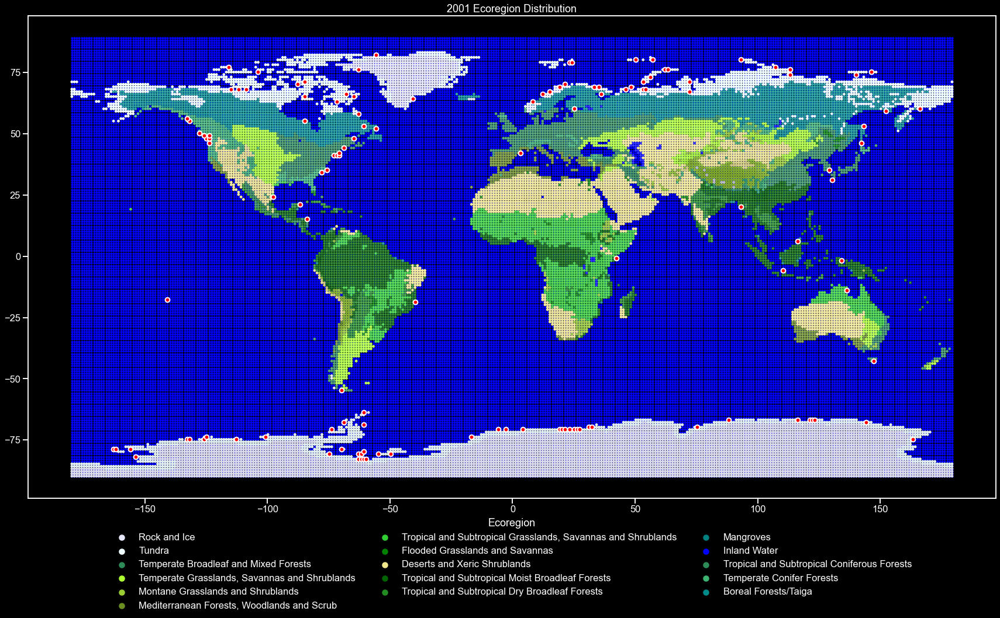

In [29]:
missing = A[A.isnull().any(axis=1)]
plotMap(A.ecoregion,A.geometry,Ageo,ocean_coords,ecoCMAP,2001,'',missing.geometry)

In [30]:
colNAs = A.columns[6:32]
fillNAs(A,colNAs)
print('\nSaving as toTrainCleaned.shp')
A.to_file("toTrainCleaned.shp")
print('\nCompleted')

	Missing values: 3354
	Missing values: 182
	Missing values: 156
	Missing values: 156
Filling in remaining missing values with mean of ecoregion.
			Remaining missing values: 0

Saving as toTrainCleaned.shp

Completed


In [31]:
T = pd.DataFrame(gpd.read_file('toTrainCleaned.shp').drop(columns='geometry'))

ecoRegDict = {r:d_v for d_v, r in enumerate(set(A.ecoregion.values))}

X = T.drop(['lon','ecoregion'],axis=1)
Y = T.ecoregion
ecoOrder = pd.DataFrame({'Ecotype':Y.value_counts(ascending=True).index.tolist()})
pcol = X.columns

## Creating training dataframe of 1990-2001

In [32]:
start, stop = 1990, 2002

features19902001 = T[pcol].copy()
for y in range(start,stop):

    featuresTemp = pd.merge(getFeatures(airtmp,'temp',coord_5,y),
                            getFeatures(precip,'prec',coord_5,y),on='id',how="inner")
    featuresTemp = pd.merge(coordLand,featuresTemp,on='id',how="left")
    featuresTemp.set_index(['lat', 'lon'],inplace=True)
    
    fillNAs(featuresTemp,colNAs)          
    featuresTemp.reset_index(inplace=True)

    features19902001 = pd.concat([features19902001,featuresTemp[pcol]],ignore_index=True)
                  

	Missing values: 3354
	Missing values: 182
	Missing values: 156
	Missing values: 156
Filling in remaining missing values with mean of ecoregion.
			Remaining missing values: 0
	Missing values: 3354
	Missing values: 182
	Missing values: 156
	Missing values: 156
Filling in remaining missing values with mean of ecoregion.
			Remaining missing values: 0
	Missing values: 3354
	Missing values: 182
	Missing values: 156
	Missing values: 156
Filling in remaining missing values with mean of ecoregion.
			Remaining missing values: 0
	Missing values: 3354
	Missing values: 182
	Missing values: 156
	Missing values: 156
Filling in remaining missing values with mean of ecoregion.
			Remaining missing values: 0
	Missing values: 3354
	Missing values: 182
	Missing values: 156
	Missing values: 156
Filling in remaining missing values with mean of ecoregion.
			Remaining missing values: 0
	Missing values: 3354
	Missing values: 182
	Missing values: 156
	Missing values: 156
Filling in remaining missing values

### Adding engineered features

In [33]:
features19902001 = createFeatures(features19902001,colNAs)
features19902001 = features19902001.astype('float')
len(features19902001.index)

279955

### Setting up features and targets for models

In [34]:
yAll = pd.Series(list(Y)*(stop-start+1)) 
all19902001 = features19902001.copy()
all19902001['ecoregion'] = yAll
time = list(all19902001.columns[6:18].values)+list(all19902001.columns[19:31].values)

### Assessing for outliers

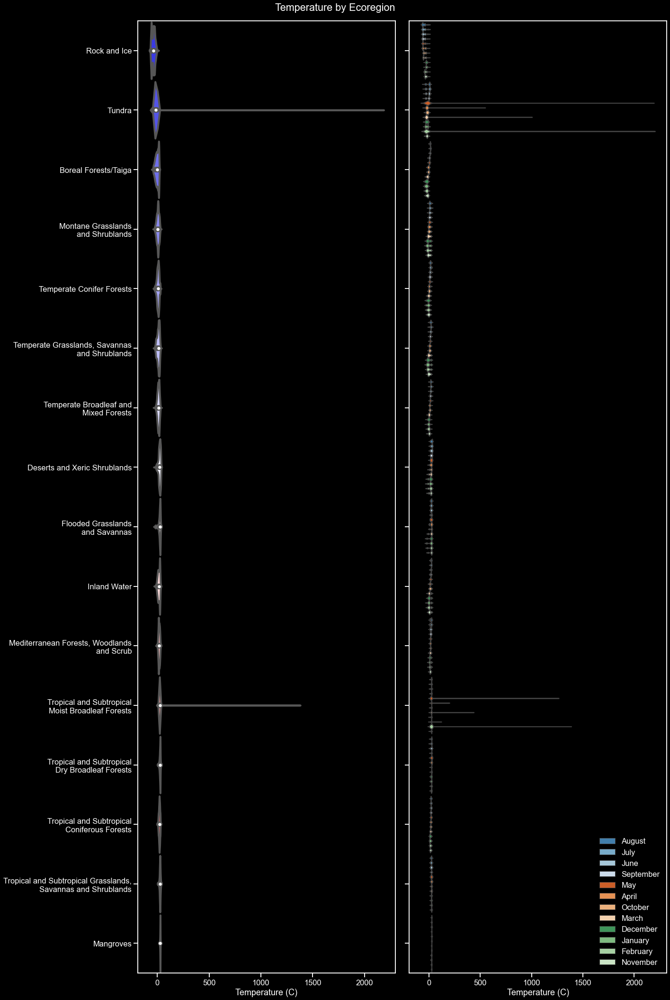

In [35]:
temp_viol = all19902001[['ecoregion']+time[:12]] 
temp_viol.columns = ['Ecoregion','January','February','March','April','May','June',
                     'July','August','September','October','November','December']
temp_viol = pd.melt(temp_viol,id_vars=['Ecoregion'],var_name='Month',value_name="Temperature (C)")
temp_viol.Ecoregion = temp_viol.Ecoregion.map(lambda s: formatTitle(s))
temp_viol.sort_values(by='Temperature (C)',inplace=True)


fig, ax = plt.subplots(ncols=2,figsize = (20,30),sharey=True)

plot1 = sns.violinplot(data=temp_viol, y='Ecoregion',x='Temperature (C)',orient='h',ax=ax[0],
                       scale='width',width=0.95,linewidth=4,palette='bwr')

plot2 = sns.violinplot(data=temp_viol, y='Ecoregion',x='Temperature (C)',hue='Month',orient='h',ax=ax[1],
                        scale='width',width=0.95,inner=None,palette='tab20c',linewidth=2)

plot1.set(ylabel=None)
plot2.set(ylabel=None)
plt.legend(loc='lower right',frameon=False)
fig.suptitle('Temperature by Ecoregion')
plt.tight_layout(rect=[0, 0, 1, 0.99])

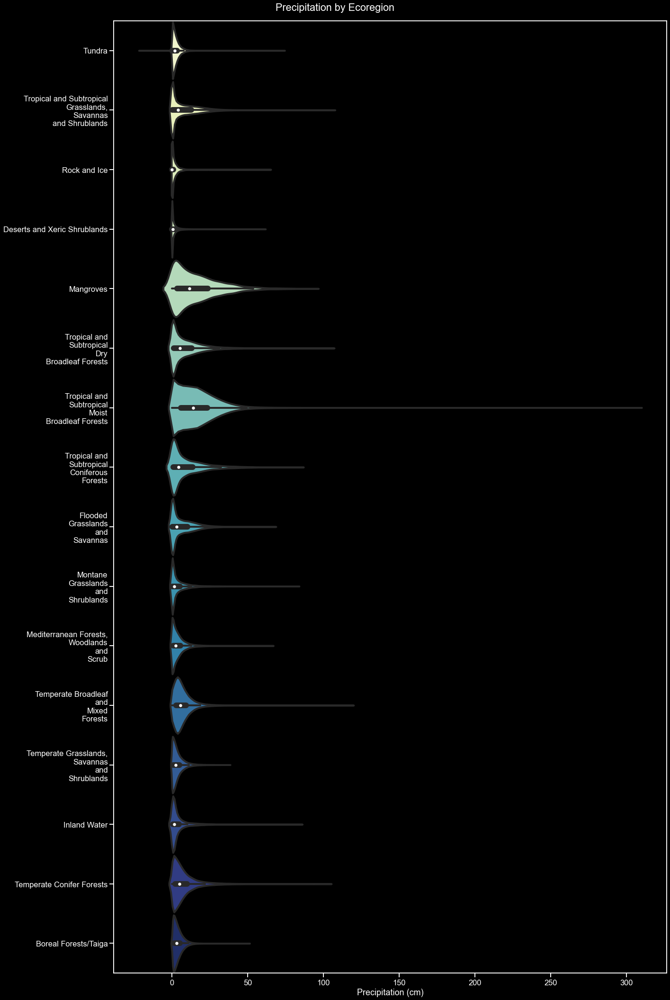

In [36]:
prec_viol = all19902001[['ecoregion']+time[12:]] 
prec_viol.columns = ['Ecoregion','January','February','March','April','May','June',
                     'July','August','September','October','November','December']
prec_viol = pd.melt(prec_viol,id_vars=['Ecoregion'],var_name='Month',value_name="Precipitation (cm)")
prec_viol.Ecoregion = temp_viol.Ecoregion.map(lambda s: formatTitle(s))
prec_viol.sort_values(by='Precipitation (cm)',inplace=True)
prec_viol.Ecoregion = prec_viol.Ecoregion.map(lambda s: formatTitle(s))

fig, ax = plt.subplots(figsize = (20,30))

plot = sns.violinplot(data=prec_viol, y='Ecoregion',x='Precipitation (cm)',orient='h',ax=ax,
                       scale='width',width=0.95,linewidth=4,palette='YlGnBu')

plot.set(ylabel=None)
fig.suptitle('Precipitation by Ecoregion')
plt.tight_layout(rect=[0, 0, 1, 0.99])

### Removing outliers

In [37]:
keep = all19902001[all19902001.temp02<95].index
all19902001 = all19902001.loc[keep]
all19902001.reset_index(inplace=True,drop=True)

filt = 'Tropical and Subtropical Dry Broadleaf Forests'
keep = all19902001[(all19902001.prec01>=0) & (all19902001.prec02>=0) & (all19902001.prec03>=0) &
                   (all19902001.prec04>=0) & (all19902001.prec04>=0)].index 

all19902001 = all19902001.loc[keep]
all19902001.reset_index(inplace=True,drop=True)

In [38]:
yAll = all19902001.ecoregion
features19902001 = all19902001.drop('ecoregion',axis=1)

### For plotting

In [39]:
temp_by_ecoregion = all19902001[['ecoregion','lat']+time[:12]].groupby(['ecoregion','lat']).mean()
temp_by_ecoregion.reset_index(inplace=True)
temp_by_ecoregion = temp_by_ecoregion[temp_by_ecoregion.ecoregion!='Inland Water']
temp_by_ecoregion.columns = ['Ecoregion','Latitude','January','February','March','April','May',
                             'June','July','August','September','October','November','December']
temp_by_ecoregion = pd.melt(temp_by_ecoregion,id_vars=['Ecoregion','Latitude'],
                            var_name='Month',value_name="Temperature")
prec_by_ecoregion = all19902001[['ecoregion','lat']+time[12:]].groupby(['ecoregion','lat']).mean()
prec_by_ecoregion.reset_index(inplace=True)
prec_by_ecoregion = prec_by_ecoregion[prec_by_ecoregion.ecoregion!='Inland Water']
prec_by_ecoregion.columns = ['Ecoregion','Latitude','January','February','March','April','May',
                             'June','July','August','September','October','November','December']
prec_by_ecoregion = pd.melt(prec_by_ecoregion,id_vars=['Ecoregion','Latitude'],
                            var_name='Month',value_name="Precipitation")

## Creating dataframe of forecasts

In [40]:
df2001 = createFeatures(getProjData(temp2001,prec2001,temp2001.columns[2:-1],eleTemp,projCoord),colNAs)
p_geom = df2001.geometry
df2001 = df2001[features19902001.columns] #ordering columns correctly
X_all = createFeatures(X,colNAs)

### Creating forecasts 

In [45]:
tFiles = [f'tas_all_{i[0][0]}_{i[0][1]}_rcp{i[1]}-180.0_180.0_-90.0_90.0.shp' for i in list(itertools.product(
                    [(2006,2019),(2020,2040),(2041,2061),(2062,2082),(2083,2100)], [26,45,60,85]))]
projCoord = gpd.read_file(tFiles[0]).drop(['GID_LON'],axis=1).geometry

In [46]:
projID = [(p.coords[0][1] ,p.coords[0][0]) for p in projCoord]
time = list(temp_2_6.drop(['GID_LAT'],axis=1).columns)[48:]
pX2_6 = [getProjData(temp_2_6,prec_2_6,time[i:i+12],eleTemp,projCoord) 
         for i in range(0,len(time),12)]

Getting projections [201001:201012]
Getting projections [201101:201112]
Getting projections [201201:201212]
Getting projections [201301:201312]
Getting projections [201401:201412]
Getting projections [201501:201512]
Getting projections [201601:201612]
Getting projections [201701:201712]
Getting projections [201801:201812]
Getting projections [201901:201912]
Getting projections [202001:202012]
Getting projections [202101:202112]
Getting projections [202201:202212]
Getting projections [202301:202312]
Getting projections [202401:202412]
Getting projections [202501:202512]
Getting projections [202601:202612]
Getting projections [202701:202712]
Getting projections [202801:202812]
Getting projections [202901:202912]
Getting projections [203001:203012]
Getting projections [203101:203112]
Getting projections [203201:203212]
Getting projections [203301:203312]
Getting projections [203401:203412]
Getting projections [203501:203512]
Getting projections [203601:203612]
Getting projections [203701:

In [47]:
iter_sea = (y for y in sea_rise.loc['_45'])
pX4_5 = [getProjData(temp_4_5,prec_4_5,time[i:i+12],eleTemp,projCoord,next(iter_sea)) 
         for i in range(0,len(time),12)]

Getting projections [201001:201012]
Getting projections [201101:201112]
Getting projections [201201:201212]
Getting projections [201301:201312]
Getting projections [201401:201412]
Getting projections [201501:201512]
Getting projections [201601:201612]
Getting projections [201701:201712]
Getting projections [201801:201812]
Getting projections [201901:201912]
Getting projections [202001:202012]
Getting projections [202101:202112]
Getting projections [202201:202212]
Getting projections [202301:202312]
Getting projections [202401:202412]
Getting projections [202501:202512]
Getting projections [202601:202612]
Getting projections [202701:202712]
Getting projections [202801:202812]
Getting projections [202901:202912]
Getting projections [203001:203012]
Getting projections [203101:203112]
Getting projections [203201:203212]
Getting projections [203301:203312]
Getting projections [203401:203412]
Getting projections [203501:203512]
Getting projections [203601:203612]
Getting projections [203701:

In [48]:
iter_sea = (y for y in sea_rise.loc['_60'])
pX6_0 = [getProjData(temp_6_0,prec_6_0,time[i:i+12],eleTemp,projCoord,next(iter_sea)) 
         for i in range(0,len(time),12)]

Getting projections [201001:201012]
Getting projections [201101:201112]
Getting projections [201201:201212]
Getting projections [201301:201312]
Getting projections [201401:201412]
Getting projections [201501:201512]
Getting projections [201601:201612]
Getting projections [201701:201712]
Getting projections [201801:201812]
Getting projections [201901:201912]
Getting projections [202001:202012]
Getting projections [202101:202112]
Getting projections [202201:202212]
Getting projections [202301:202312]
Getting projections [202401:202412]
Getting projections [202501:202512]
Getting projections [202601:202612]
Getting projections [202701:202712]
Getting projections [202801:202812]
Getting projections [202901:202912]
Getting projections [203001:203012]
Getting projections [203101:203112]
Getting projections [203201:203212]
Getting projections [203301:203312]
Getting projections [203401:203412]
Getting projections [203501:203512]
Getting projections [203601:203612]
Getting projections [203701:

In [49]:
iter_sea = (y for y in sea_rise.loc['_85'])
pX8_5 = [getProjData(temp_8_5,prec_4_5,time[i:i+12],eleTemp,projCoord,next(iter_sea)) 
         for i in range(0,len(time),12)]

Getting projections [201001:201012]
Getting projections [201101:201112]
Getting projections [201201:201212]
Getting projections [201301:201312]
Getting projections [201401:201412]
Getting projections [201501:201512]
Getting projections [201601:201612]
Getting projections [201701:201712]
Getting projections [201801:201812]
Getting projections [201901:201912]
Getting projections [202001:202012]
Getting projections [202101:202112]
Getting projections [202201:202212]
Getting projections [202301:202312]
Getting projections [202401:202412]
Getting projections [202501:202512]
Getting projections [202601:202612]
Getting projections [202701:202712]
Getting projections [202801:202812]
Getting projections [202901:202912]
Getting projections [203001:203012]
Getting projections [203101:203112]
Getting projections [203201:203212]
Getting projections [203301:203312]
Getting projections [203401:203412]
Getting projections [203501:203512]
Getting projections [203601:203612]
Getting projections [203701:

### Adding engineered features to forecasts

In [50]:
pX2_6_all = [createFeatures(df,colNAs) for df in pX2_6]
pX4_5_all = [createFeatures(df,colNAs) for df in pX4_5]
pX6_0_all = [createFeatures(df,colNAs) for df in pX6_0]
pX8_5_all = [createFeatures(df,colNAs) for df in pX8_5]

lat_area_dict = {l:(2*gpd.GeoSeries(Polygon([(0,l),(lon_dif,l),(0,l-lat_dif)]),
                 crs='epsg:4326').to_crs({'proj': 'cea'}).area/10**6)[0] for l in set(pX2_6_all[0].lat.abs())}

## Dataframe of ocean vs land coordinates (for sea level rise forecasts)

In [51]:
longitudes = sorted(list(set(p.x for p in temp_8_5.geometry)))
latitudes  = sorted(list(set(p.y for p in temp_8_5.geometry)))

lat_dict = {latitudes[ 0]:{'N':latitudes[ 1],'S':latitudes[ 0]},
            latitudes[-1]:{'N':latitudes[-1],'S':latitudes[-2]}}
for l in range(len(latitudes[1:])):
    lat_dict[latitudes[l]] = {'N':latitudes[l+1],'S':latitudes[l-1]}

lon_dict = {longitudes[ 0]:{'W':longitudes[-1],'E':longitudes[ 1]},
            longitudes[-1]:{'W':longitudes[-2],'E':longitudes[ 0]}}
for l in range(len(longitudes[1:])):
    lon_dict[longitudes[l]] = {'W':longitudes[l-1],'E':longitudes[l+1]}

land = [(p.x,p.y) for p in pX2_6_all[0].geometry]

terrain = pd.DataFrame({'terrain':['ocean']*len(longitudes)*len(latitudes)},
                        index=pd.MultiIndex.from_product([longitudes, latitudes],names=['longitude', 'latitude']))
terrain['lon'], terrain['lat'] = terrain.index.get_level_values(0), terrain.index.get_level_values(1)
terrain.loc[land,'terrain'] = 'land'

p4_5_ocean = generateSLR(pX4_5,terrain.copy())
p6_0_ocean = generateSLR(pX6_0,terrain.copy())
p8_5_ocean = generateSLR(pX8_5,terrain.copy())

<ipython-input-19-ee4e924aa770>:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  update = t.loc[negative][t.terrain == 'land'].apply(lambda i:'ocean' if
<ipython-input-19-ee4e924aa770>:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  update = t.loc[negative][t.terrain == 'land'].apply(lambda i:'ocean' if
<ipython-input-19-ee4e924aa770>:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  update = t.loc[negative][t.terrain == 'land'].apply(lambda i:'ocean' if
<ipython-input-19-ee4e924aa770>:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  update = t.loc[negative][t.terrain == 'land'].apply(lambda i:'ocean' if
<ipython-input-19-ee4e924aa770>:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  update = t.loc[negative][t.terrain == 'land'].apply(lambda i:'ocean' if
<ipython-input-19-ee4e924aa770>:5: UserWarning: Boolean Series key will be 

## Checking support for ecotypes

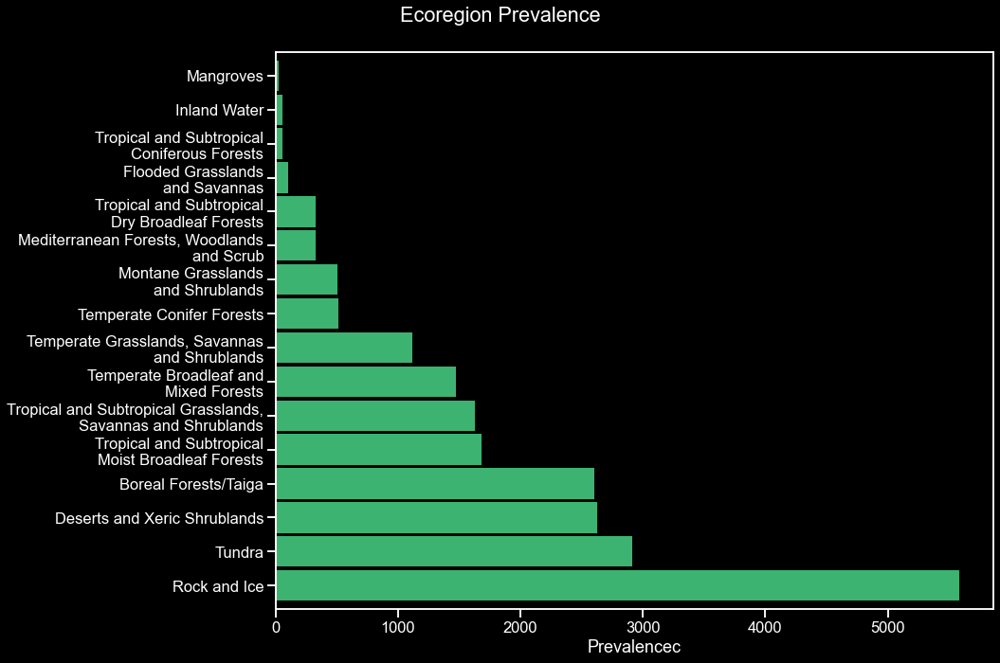

In [52]:
fig, ax = plt.subplots(figsize = (15,10))
support = Y.copy()
support = support.map(lambda s: formatTitle(s))
support.value_counts().plot(kind='barh',ax=ax,width=0.9,linewidth=0,color='mediumseagreen')
fig.suptitle('Ecoregion Prevalence')
plt.xlabel('Prevalencec')
plt.tight_layout(rect=[0, 0, 1, 0.995])

## Monthly trends by ecotype

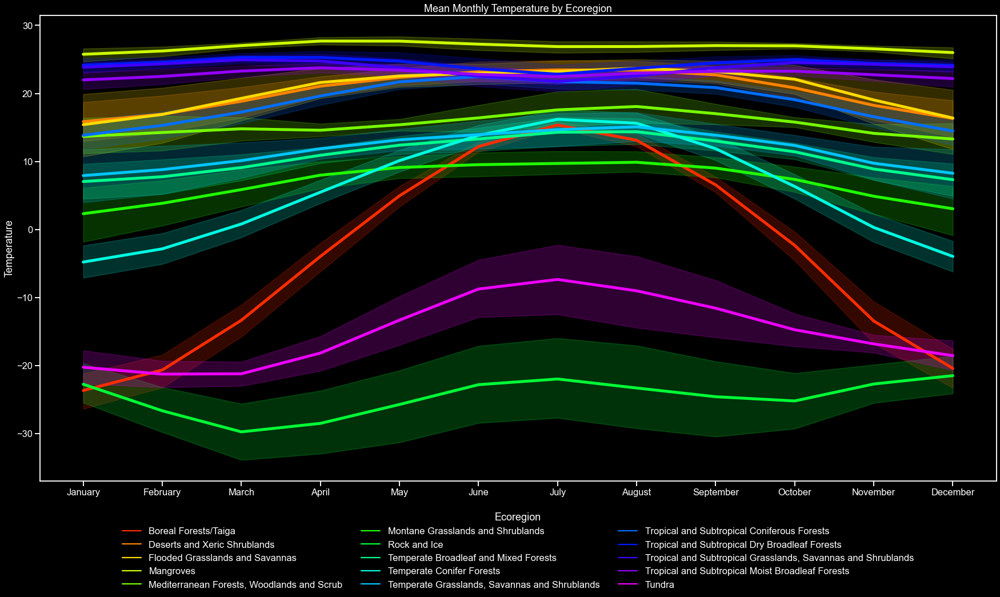

In [53]:
plotMonthAvg(temp_by_ecoregion,'Temperature')

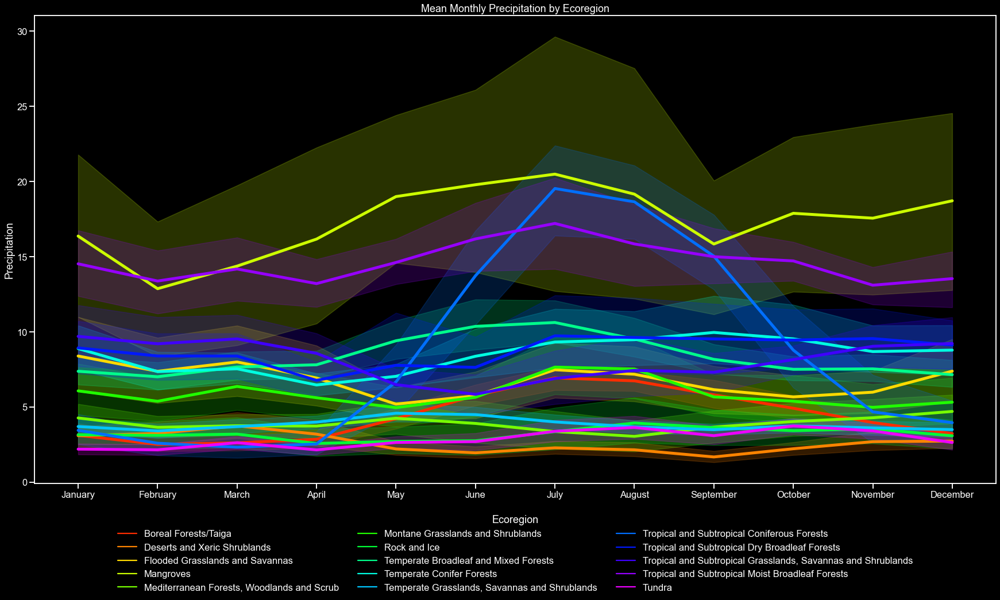

In [54]:
plotMonthAvg(prec_by_ecoregion,'Precipitation')

## Monthly trends by ecotype/latitude

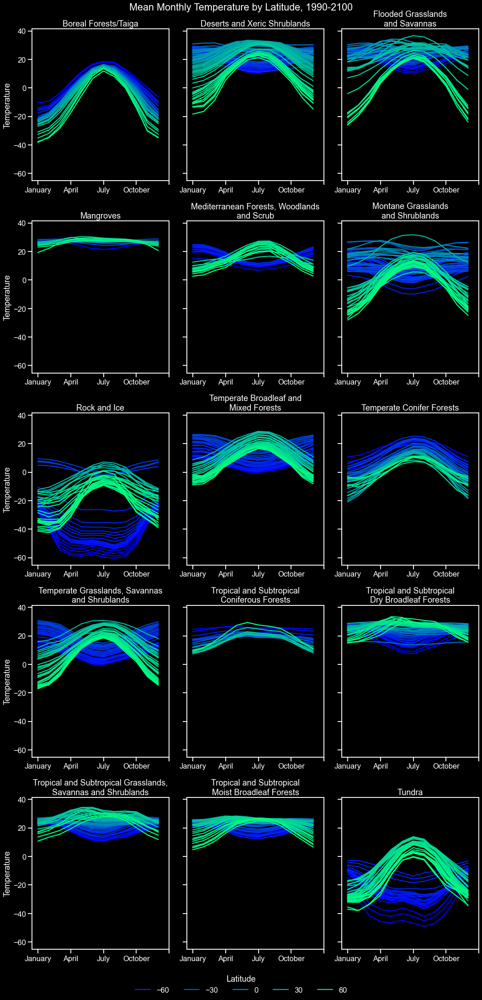

In [55]:
plotEcoMonthAvg(temp_by_ecoregion,'Temperature',ecoCMAP)

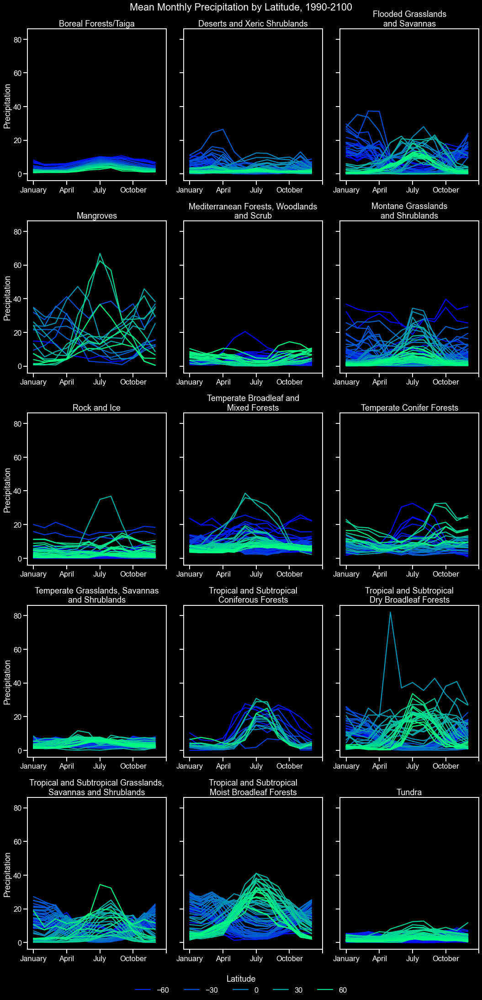

In [56]:
plotEcoMonthAvg(prec_by_ecoregion,'Precipitation',ecoCMAP)

## Amalgamated data by ecotype

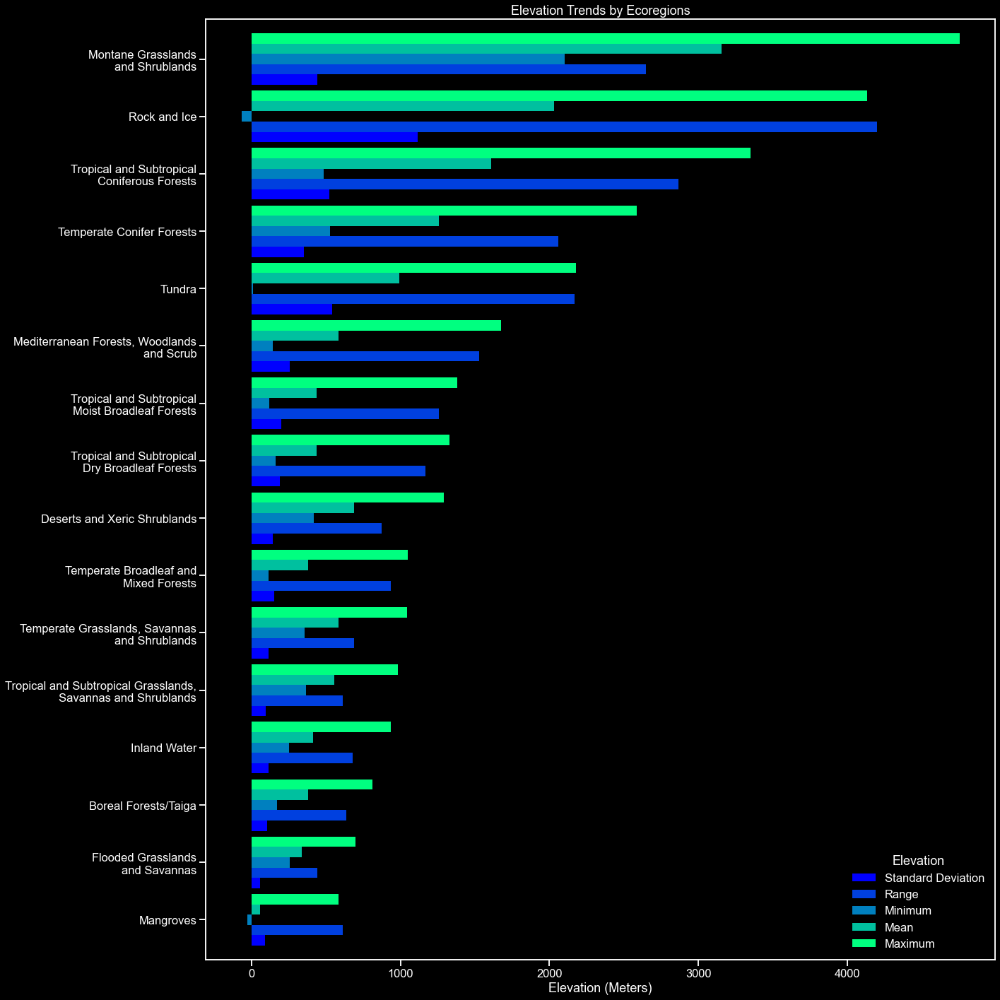

In [57]:
fig, ax = plt.subplots(figsize = (20,20))
elev_plot = all19902001.groupby('ecoregion')[['elev_sd','elev_dif','elev_min','elev_avg','elev_max']].mean()
elev_plot.columns  = ['Standard Deviation','Range','Minimum','Mean','Maximum']
elev_plot.sort_values(by='Maximum',inplace=True)
elev_plot.index = [formatTitle(s) for s in elev_plot.index]
elev_plot.plot(kind='barh',ax=ax,width=0.9,linewidth=0,title='Elevation Trends by Ecoregions',
               colormap='winter',legend='reverse')
plt.xlabel('Elevation (Meters)')
plt.legend(title='Elevation',frameon=False)
plt.tight_layout()

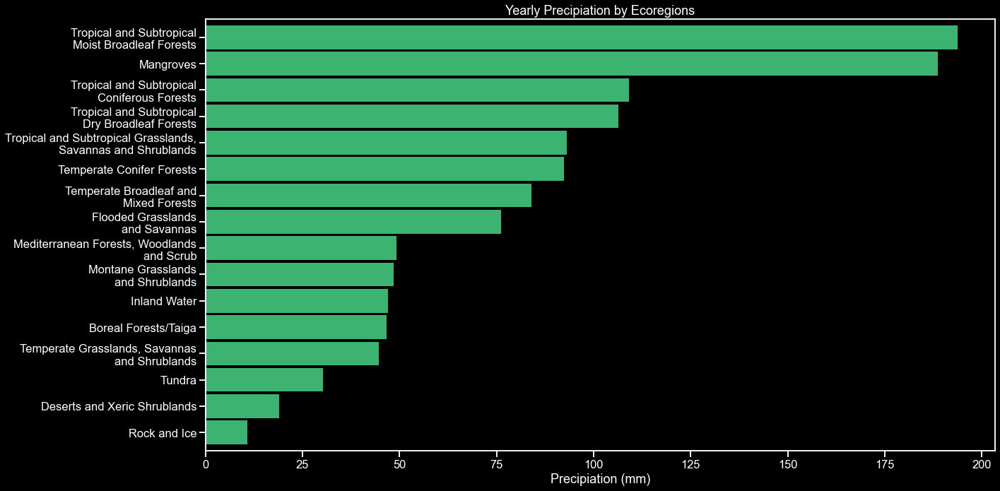

In [58]:
prec_plot = all19902001.groupby('ecoregion')['P_annual'].mean()
prec_plot.columns = ['Annual Precipiation']
prec_plot.index = [formatTitle(s) for s in prec_plot.index]
prec_plot = prec_plot.sort_values()

fig, ax = plt.subplots(figsize = (20,10))
prec_plot.plot(kind='barh',ax=ax,width=0.9,linewidth=0,title='Yearly Precipiation by Ecoregions',
               color='mediumseagreen')
plt.xlabel('Precipiation (mm)')
plt.tight_layout()

## Sea level rise scenarios

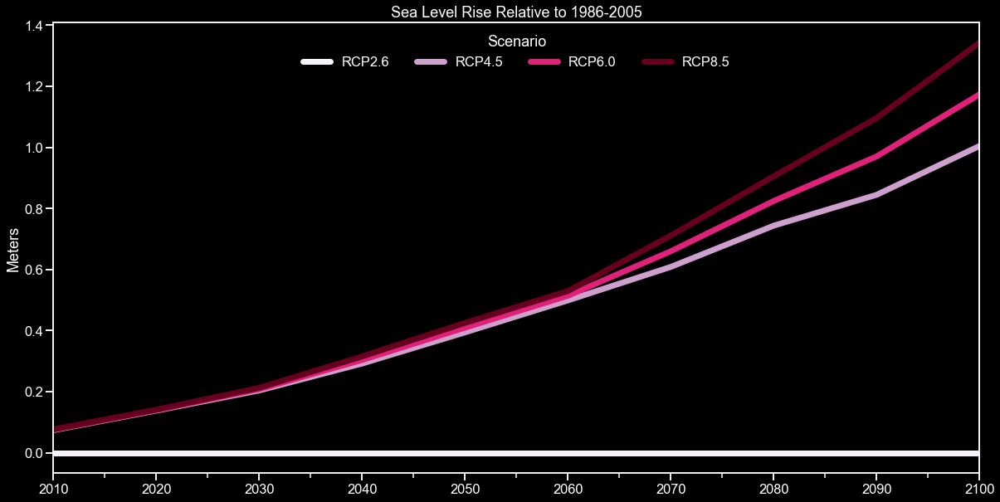

In [59]:
fig, ax = plt.subplots(figsize = (20,10))
searisePlot = sea_rise.copy()
searisePlot.index=['RCP2.6','RCP4.5','RCP8.5','RCP6.0']
searisePlot = searisePlot.reindex(index=['RCP2.6','RCP4.5','RCP6.0','RCP8.5'])
searisePlot.T.plot(ax=ax, title='Sea Level Rise Relative to 1986-2005',colormap='PuRd',linewidth=7)
plt.ylabel('Meters')
ax.legend(loc='upper center',title='Scenario',ncol=4,frameon=False)

## Projected trends by ecoregion

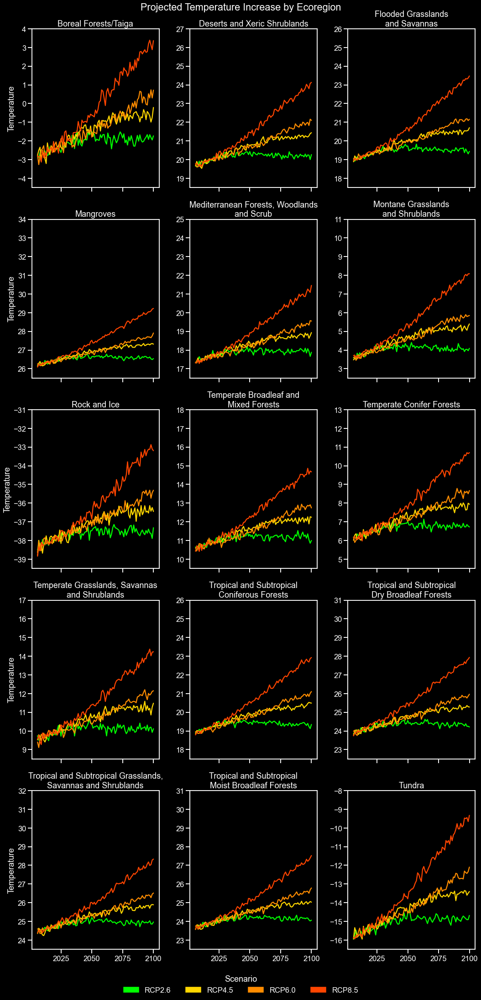

In [60]:
projectScenarios(ts2_6,ts4_5,ts6_0,ts8_5,ecoCMAP,'Temperature')

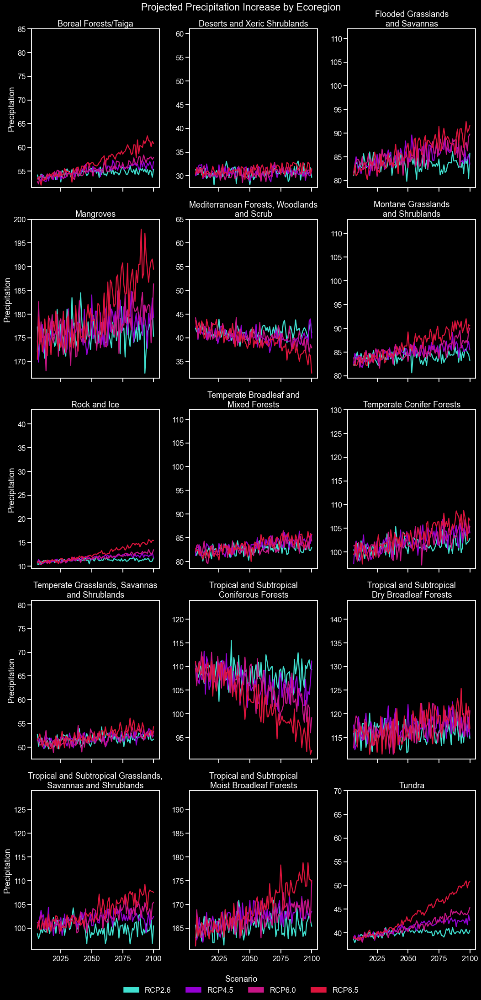

In [61]:
projectScenarios(ps2_6,ps4_5,ps6_0,ps8_5,ecoCMAP,'Precipitation')

## Random Forests using all features

In [62]:
rf_model_b = runRandomForest(features19902001,yAll,n_e=200,oversample=True)

Target Frequencies:

Rock and Ice                                                    0.259418
Tundra                                                          0.135213
Deserts and Xeric Shrublands                                    0.121836
Boreal Forests/Taiga                                            0.120767
Tropical and Subtropical Moist Broadleaf Forests                0.077988
Tropical and Subtropical Grasslands, Savannas and Shrublands    0.075758
Temperate Broadleaf and Mixed Forests                           0.068373
Temperate Grasslands, Savannas and Shrublands                   0.052023
Temperate Conifer Forests                                       0.023689
Montane Grasslands and Shrublands                               0.023457
Mediterranean Forests, Woodlands and Scrub                      0.015189
Tropical and Subtropical Dry Broadleaf Forests                  0.015049
Flooded Grasslands and Savannas                                 0.004784
Tropical and Subtropical Conif

In [63]:
f_importance = pd.DataFrame({'Features':features19902001.columns,
                             'Importance':rf_model_b.feature_importances_}).sort_values(
                          by='Importance',ascending=False).reset_index(drop=True)
f_importance

,Features,Importance
0,elev_avg,0.076856
1,lat,0.069243
2,elev_max,0.056842
3,elev_min,0.056288
4,elev_sd,0.043834
5,elev_dif,0.041077
6,tempAvg,0.033912
7,temp04,0.030404
8,temp05,0.028837
9,T_q_warmest,0.026181


<AxesSubplot:xlabel='Importance', ylabel='Features'>

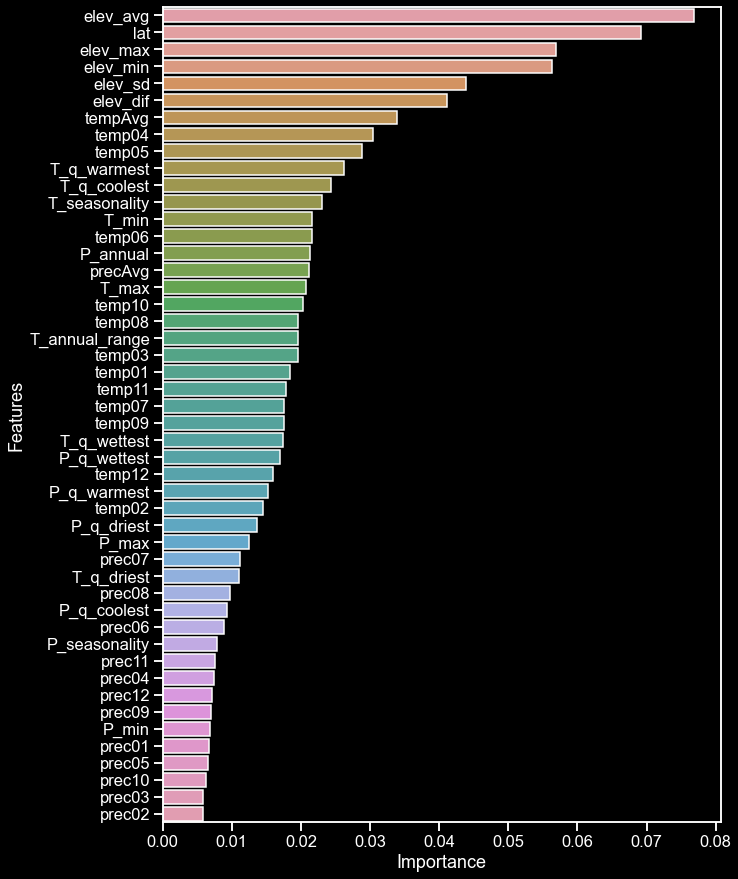

In [64]:
fig,ax = plt.subplots(figsize=(10,15))
sns.barplot(y='Features',x='Importance',data=f_importance,orient='h',saturation=0.6,dodge=False,ax=ax)

## Using top 14 features

In [65]:
top_14 = list(f_importance.iloc[:15].Features)
rf_model_14 = runRandomForest(features19902001[top_14],yAll,n_e=200,oversample=True)

Target Frequencies:

Rock and Ice                                                    0.259418
Tundra                                                          0.135213
Deserts and Xeric Shrublands                                    0.121836
Boreal Forests/Taiga                                            0.120767
Tropical and Subtropical Moist Broadleaf Forests                0.077988
Tropical and Subtropical Grasslands, Savannas and Shrublands    0.075758
Temperate Broadleaf and Mixed Forests                           0.068373
Temperate Grasslands, Savannas and Shrublands                   0.052023
Temperate Conifer Forests                                       0.023689
Montane Grasslands and Shrublands                               0.023457
Mediterranean Forests, Woodlands and Scrub                      0.015189
Tropical and Subtropical Dry Broadleaf Forests                  0.015049
Flooded Grasslands and Savannas                                 0.004784
Tropical and Subtropical Conif

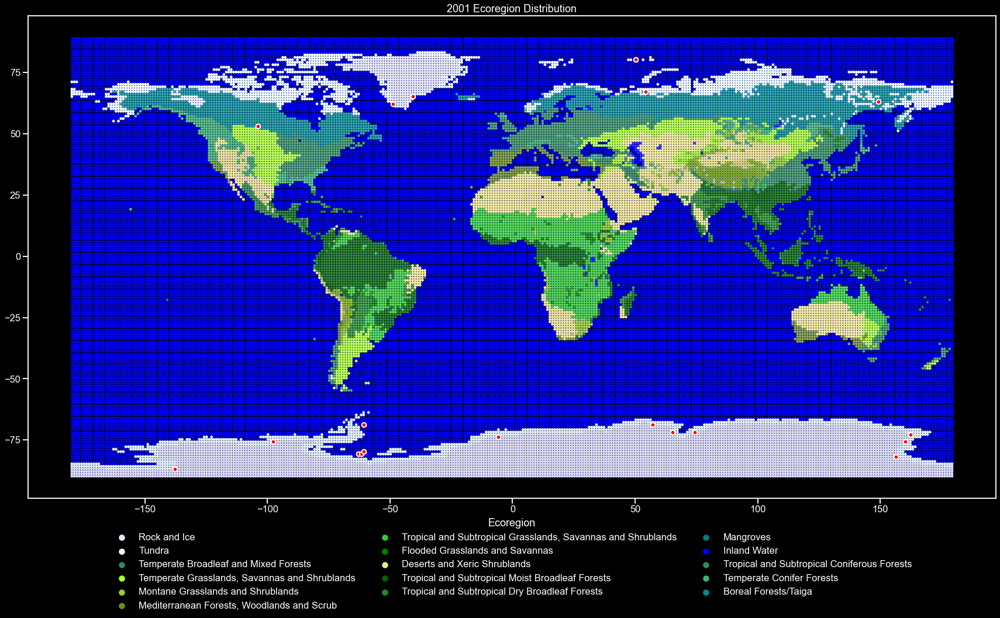

Observed              Predicted                                    
Rock and Ice          Tundra                                           10
Tundra                Deserts and Xeric Shrublands                      5
Boreal Forests/Taiga  Temperate Grasslands, Savannas and Shrublands     1
                      Tundra                                            1
Tundra                Boreal Forests/Taiga                              1
                      Rock and Ice                                      1
dtype: int64


In [66]:
compare = pd.DataFrame({'lat':T.lat,'lon':T.lon,'Observed':Y, 
                        'Predicted':rf_model_14.predict(X_all[top_14]).reshape(21535,)})
wrong = compare[compare.Observed!=compare.Predicted]
wrong = gpd.GeoDataFrame(wrong,geometry=gpd.points_from_xy(wrong.lon, wrong.lat),crs='epsg:4326')

plotMap(A.ecoregion,A.geometry,Ageo,ocean_coords,ecoCMAP,2001,'',wrong)
print(wrong.groupby(['Observed','Predicted']).size().sort_values(ascending=False))

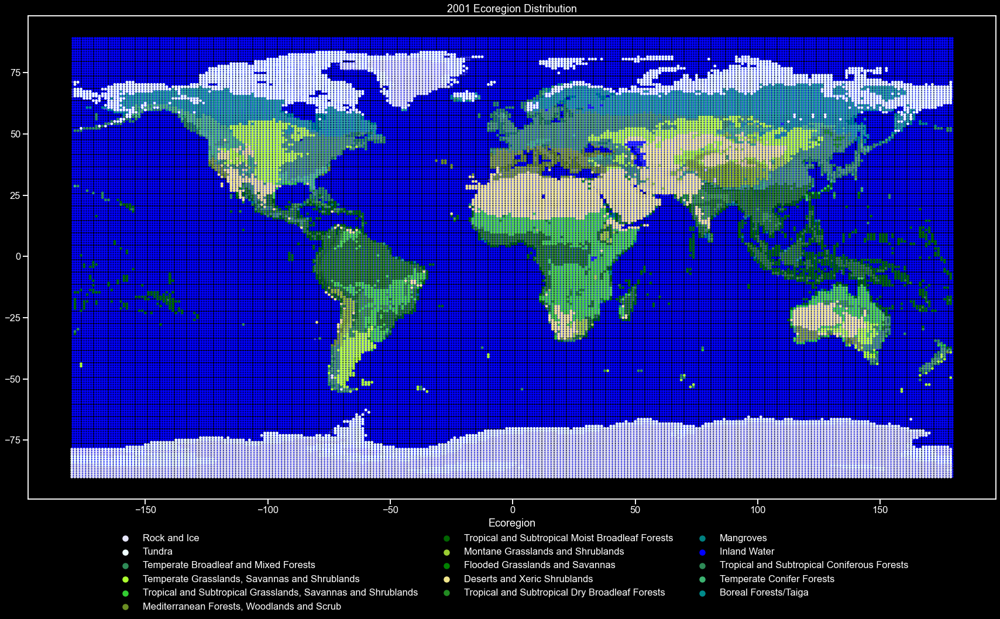

In [67]:
predict = rf_model_14.predict(df2001[top_14])
predGeog = gpd.GeoDataFrame(predict,geometry=p_geom)
plotMap(predGeog[0],predGeog.geometry,Ageo,ocean_coords,ecoCMAP,2001,'')

## All features excluding latitude

In [68]:
rf_model_no_lat = runRandomForest(features19902001.drop('lat',axis=1),yAll,n_e=200,oversample=True)
pickle.dump(rf_model_no_lat,  open('rf_model_no_lat.pkl','wb'))

Target Frequencies:

Rock and Ice                                                    0.259418
Tundra                                                          0.135213
Deserts and Xeric Shrublands                                    0.121836
Boreal Forests/Taiga                                            0.120767
Tropical and Subtropical Moist Broadleaf Forests                0.077988
Tropical and Subtropical Grasslands, Savannas and Shrublands    0.075758
Temperate Broadleaf and Mixed Forests                           0.068373
Temperate Grasslands, Savannas and Shrublands                   0.052023
Temperate Conifer Forests                                       0.023689
Montane Grasslands and Shrublands                               0.023457
Mediterranean Forests, Woodlands and Scrub                      0.015189
Tropical and Subtropical Dry Broadleaf Forests                  0.015049
Flooded Grasslands and Savannas                                 0.004784
Tropical and Subtropical Conif

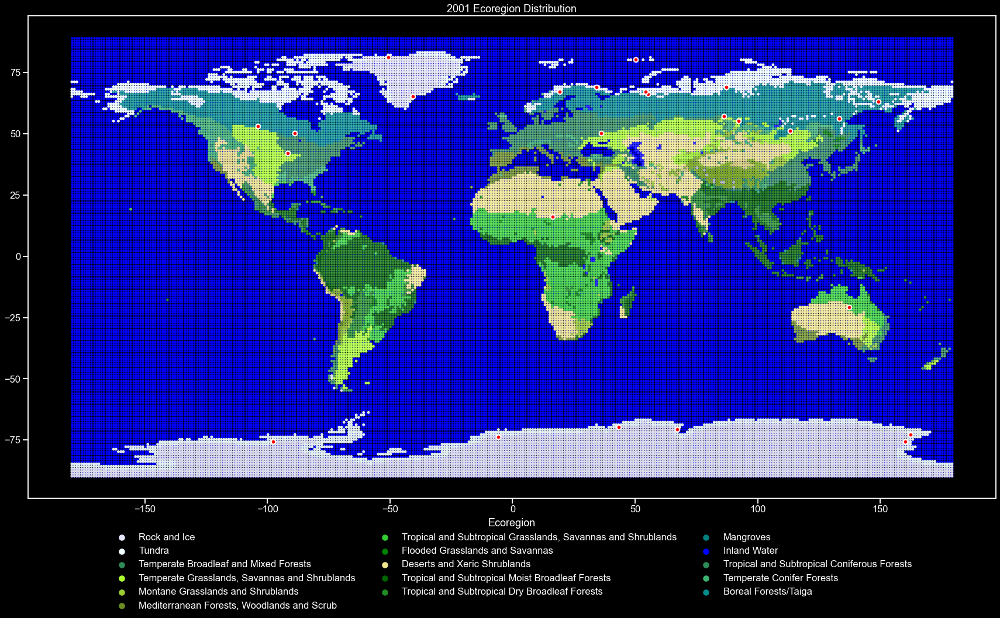

Observed                               Predicted                                                   
Rock and Ice                           Tundra                                                          5
Tundra                                 Boreal Forests/Taiga                                            5
Boreal Forests/Taiga                   Temperate Grasslands, Savannas and Shrublands                   3
Tundra                                 Rock and Ice                                                    3
Boreal Forests/Taiga                   Tundra                                                          2
Deserts and Xeric Shrublands           Tropical and Subtropical Grasslands, Savannas and Shrublands    2
Temperate Broadleaf and Mixed Forests  Temperate Grasslands, Savannas and Shrublands                   2
Boreal Forests/Taiga                   Temperate Broadleaf and Mixed Forests                           1
Temperate Broadleaf and Mixed Forests  Boreal Forests/Taiga 

In [69]:
compare = pd.DataFrame({'lat':T.lat,'lon':T.lon,'Observed':Y, 
                        'Predicted':rf_model_no_lat.predict(X_all.drop('lat',axis=1)).reshape(21535,)})
wrong = compare[compare.Observed!=compare.Predicted]
wrong = gpd.GeoDataFrame(wrong,geometry=gpd.points_from_xy(wrong.lon, wrong.lat),crs='epsg:4326')

plotMap(A.ecoregion,A.geometry,Ageo,ocean_coords,ecoCMAP,2001,'',wrong)
print(wrong.groupby(['Observed','Predicted']).size().sort_values(ascending=False))

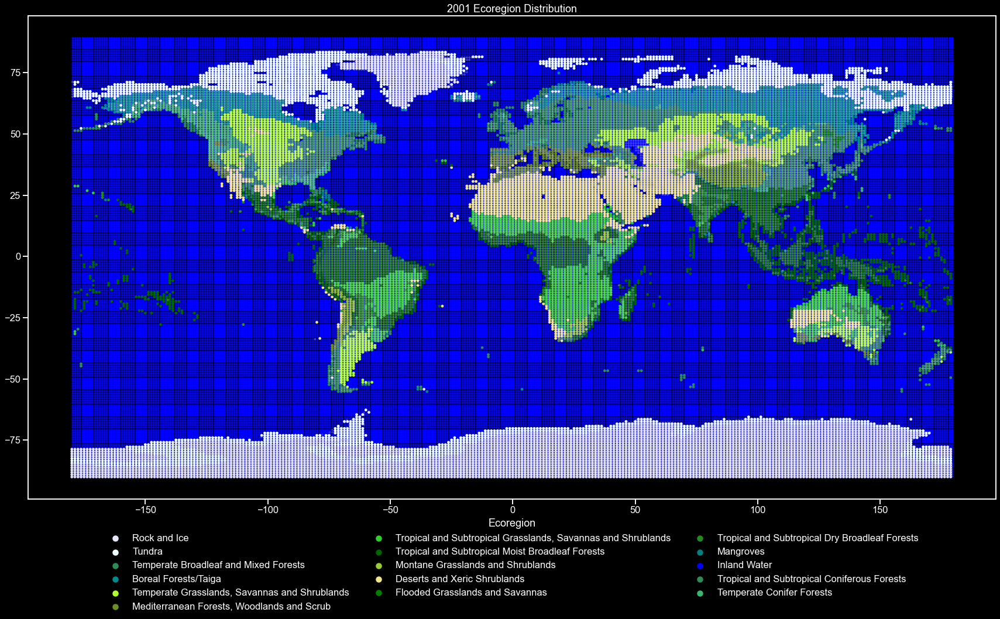

In [70]:
predict = rf_model_no_lat.predict(df2001.drop('lat',axis=1))
predGeog = gpd.GeoDataFrame(predict,geometry=p_geom)
plotMap(predGeog[0],predGeog.geometry,Ageo,ocean_coords,ecoCMAP,2001,'')

## Creating Projections

In [71]:
#Model with top 14 features and oversampling
pred2_6_14 = [rf_model_14.predict(x[top_14]).reshape(22369,) for x in pX2_6_all]
pred4_5_14 = [rf_model_14.predict(x[top_14]).reshape(22369,) for x in pX4_5_all]
pred6_0_14 = [rf_model_14.predict(x[top_14]).reshape(22369,) for x in pX6_0_all]
pred8_5_14 = [rf_model_14.predict(x[top_14]).reshape(22369,) for x in pX8_5_all]

model_c = [pred2_6_14,pred4_5_14,pred6_0_14,pred8_5_14]

In [72]:
pred2_6_nolat = [rf_model_no_lat.predict(x.drop(['lat','geometry'],axis=1)).reshape(22369,) for x in pX2_6_all]
pred4_5_nolat = [rf_model_no_lat.predict(x.drop(['lat','geometry'],axis=1)).reshape(22369,) for x in pX4_5_all]
pred6_0_nolat = [rf_model_no_lat.predict(x.drop(['lat','geometry'],axis=1)).reshape(22369,) for x in pX6_0_all]
pred8_5_nolat = [rf_model_no_lat.predict(x.drop(['lat','geometry'],axis=1)).reshape(22369,) for x in pX8_5_all]

model_no_lat = [pred2_6_nolat,pred4_5_nolat,pred6_0_nolat,pred8_5_nolat]

## Plots of projections

## Removing inland water as a target

### Top 14 features 

In [73]:
features19902001_noh2o = features19902001[yAll!='Inland Water']
rf = runRandomForest(features19902001_noh2o[top_14],yAll[yAll!='Inland Water'],n_e=200,oversample=True)
pickle.dump(rf,  open('rf.pkl','wb'))

Target Frequencies:

Rock and Ice                                                    0.260070
Tundra                                                          0.135553
Deserts and Xeric Shrublands                                    0.122142
Boreal Forests/Taiga                                            0.121071
Tropical and Subtropical Moist Broadleaf Forests                0.078184
Tropical and Subtropical Grasslands, Savannas and Shrublands    0.075949
Temperate Broadleaf and Mixed Forests                           0.068545
Temperate Grasslands, Savannas and Shrublands                   0.052154
Temperate Conifer Forests                                       0.023749
Montane Grasslands and Shrublands                               0.023516
Mediterranean Forests, Woodlands and Scrub                      0.015227
Tropical and Subtropical Dry Broadleaf Forests                  0.015087
Flooded Grasslands and Savannas                                 0.004796
Tropical and Subtropical Conif

In [74]:
p_2_6 = [rf.predict(x[top_14]).reshape(22369,) for x in pX2_6_all]
p_4_5 = [rf.predict(x[top_14]).reshape(22369,) for x in pX4_5_all]
p_6_0 = [rf.predict(x[top_14]).reshape(22369,) for x in pX6_0_all]
p_8_5 = [rf.predict(x[top_14]).reshape(22369,) for x in pX8_5_all]

models = [p_2_6,p_4_5,p_6_0,p_8_5]

### All features excluding latitude

In [75]:
features19902001_noh2o = features19902001[yAll!='Inland Water']
rf_no_lat = runRandomForest(features19902001_noh2o,yAll[yAll!='Inland Water'],n_e=200,oversample=True)

Target Frequencies:

Rock and Ice                                                    0.260070
Tundra                                                          0.135553
Deserts and Xeric Shrublands                                    0.122142
Boreal Forests/Taiga                                            0.121071
Tropical and Subtropical Moist Broadleaf Forests                0.078184
Tropical and Subtropical Grasslands, Savannas and Shrublands    0.075949
Temperate Broadleaf and Mixed Forests                           0.068545
Temperate Grasslands, Savannas and Shrublands                   0.052154
Temperate Conifer Forests                                       0.023749
Montane Grasslands and Shrublands                               0.023516
Mediterranean Forests, Woodlands and Scrub                      0.015227
Tropical and Subtropical Dry Broadleaf Forests                  0.015087
Flooded Grasslands and Savannas                                 0.004796
Tropical and Subtropical Conif

In [76]:
p_2_6_lat = [rf_no_lat.predict(x.drop('geometry',axis=1)).reshape(22369,) for x in pX2_6_all]
p_4_5_lat = [rf_no_lat.predict(x.drop('geometry',axis=1)).reshape(22369,) for x in pX4_5_all]
p_6_0_lat = [rf_no_lat.predict(x.drop('geometry',axis=1)).reshape(22369,) for x in pX6_0_all]
p_8_5_lat = [rf_no_lat.predict(x.drop('geometry',axis=1)).reshape(22369,) for x in pX8_5_all]

models_no_lat = [p_2_6_lat,p_4_5_lat,p_6_0_lat,p_8_5_lat]

## Plotting updated models

### Top 14 features

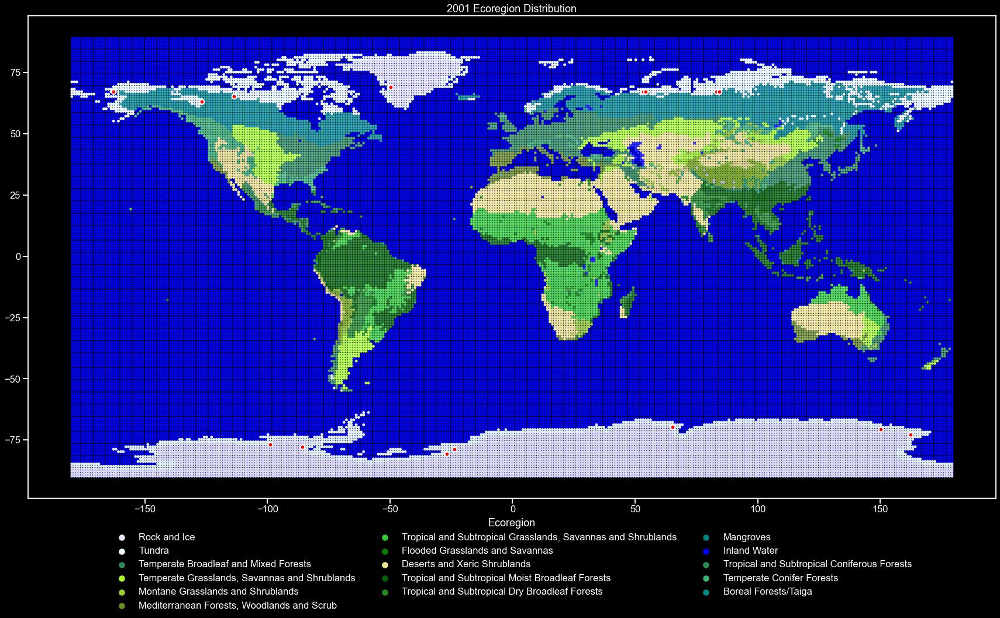

Observed              Predicted           
Rock and Ice          Tundra                  6
Boreal Forests/Taiga  Tundra                  4
Tundra                Boreal Forests/Taiga    3
                      Rock and Ice            2
dtype: int64


In [77]:
X_all_noh20 = X_all[Y!='Inland Water']
compare = pd.DataFrame({'lat':T[Y!='Inland Water'].lat,'lon':T[Y!='Inland Water'].lon,
                        'Observed':Y[Y!='Inland Water'],
                        'Predicted':rf.predict(X_all_noh20[top_14]).reshape(21481,)})

wrong = compare[compare.Observed!=compare.Predicted]
wrong = gpd.GeoDataFrame(wrong,geometry=gpd.points_from_xy(wrong.lon, wrong.lat),crs='epsg:4326')

plotMap(A.ecoregion,A.geometry,Ageo,ocean_coords,ecoCMAP,2001,'',wrong)
print(wrong.groupby(['Observed','Predicted']).size().sort_values(ascending=False))

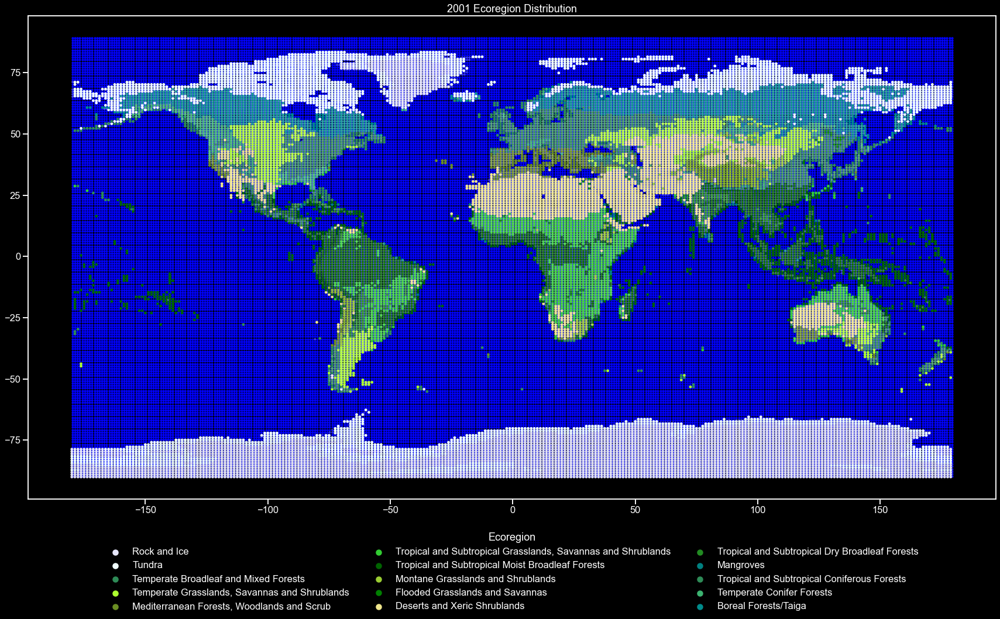

In [78]:
predict = rf.predict(df2001[top_14])
predGeog = gpd.GeoDataFrame(predict,geometry=p_geom)
plotMap(predGeog[0],predGeog.geometry,Ageo,ocean_coords,ecoCMAP,2001,'')

### All features excluding latitude

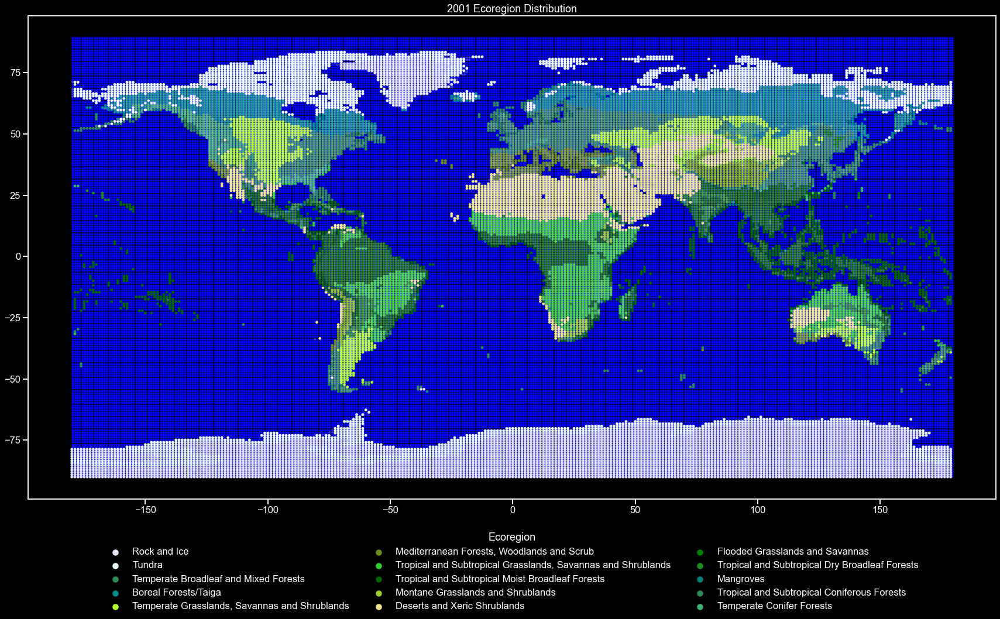

In [80]:
predict = rf_no_lat.predict(df2001)
predGeog = gpd.GeoDataFrame(predict,geometry=p_geom)
plotMap(predGeog[0],predGeog.geometry,Ageo,ocean_coords,ecoCMAP,2001,'')

## Adding sea level rise

### Generating projections

In [81]:
p4_5_SLR , p6_0_SLR , p8_5_SLR = [] , [] , []

for i in range(len(p_4_5)):
    p = pd.DataFrame({'ecoregion':models[1][i]},index=land)
    p.ecoregion.loc[ p4_5_ocean[i].loc[land][ p4_5_ocean[i].terrain=='ocean'].index ] = 'New Ocean'
    p4_5_SLR.append(p.ecoregion.values)

    p = pd.DataFrame({'ecoregion':models[2][i]},index=land)
    p.ecoregion.loc[ p6_0_ocean[i].loc[land][ p6_0_ocean[i].terrain=='ocean'].index ] = 'New Ocean'
    p6_0_SLR.append(p.ecoregion.values)

    p = pd.DataFrame({'ecoregion':models[3][i]},index=land)
    p.ecoregion.loc[ p8_5_ocean[i].loc[land][ p8_5_ocean[i].terrain=='ocean'].index ] = 'New Ocean'
    p8_5_SLR.append(p.ecoregion.values)

models_SLR = [p_2_6,p4_5_SLR,p6_0_SLR,p8_5_SLR]

<ipython-input-81-aebda766b051>:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  p.ecoregion.loc[ p4_5_ocean[i].loc[land][ p4_5_ocean[i].terrain=='ocean'].index ] = 'New Ocean'
<ipython-input-81-aebda766b051>:9: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  p.ecoregion.loc[ p6_0_ocean[i].loc[land][ p6_0_ocean[i].terrain=='ocean'].index ] = 'New Ocean'
<ipython-input-81-aebda766b051>:13: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  p.ecoregion.loc[ p8_5_ocean[i].loc[land][ p8_5_ocean[i].terrain=='ocean'].index ] = 'New Ocean'


### Top 14 features

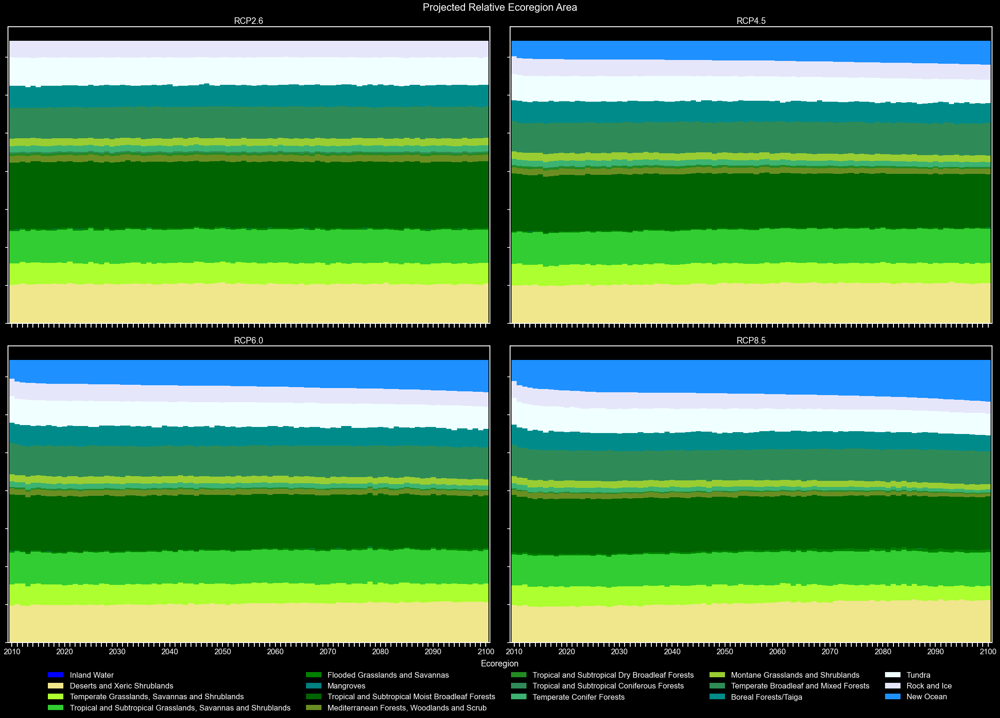

In [82]:
e_areas = projectArea(models_SLR,pX2_6_all[0].lat,tempColumns,ecoCMAP,lat_area_dict)

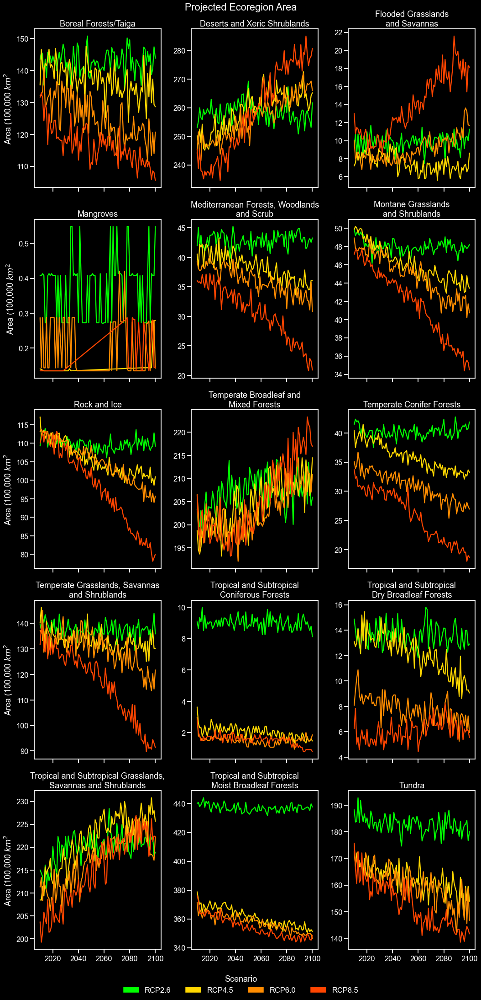

In [83]:
projectScenarios2(e_areas,ecoCMAP)

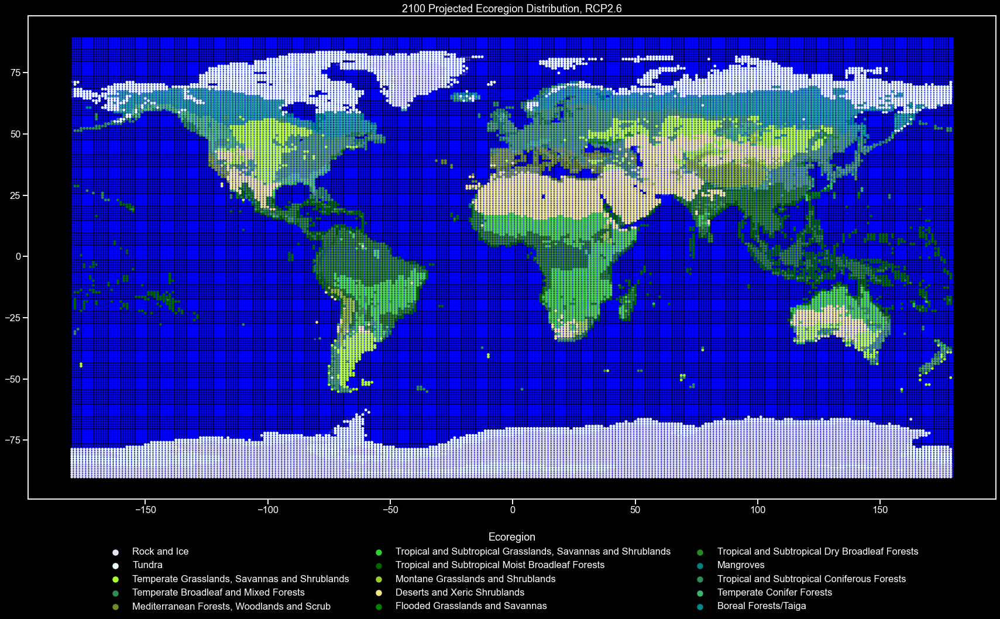

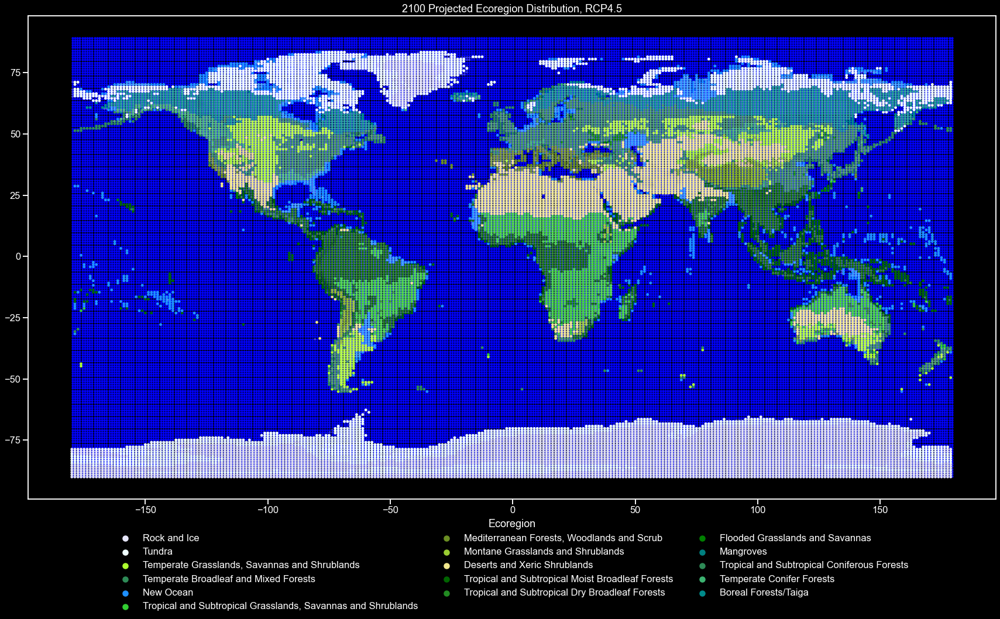

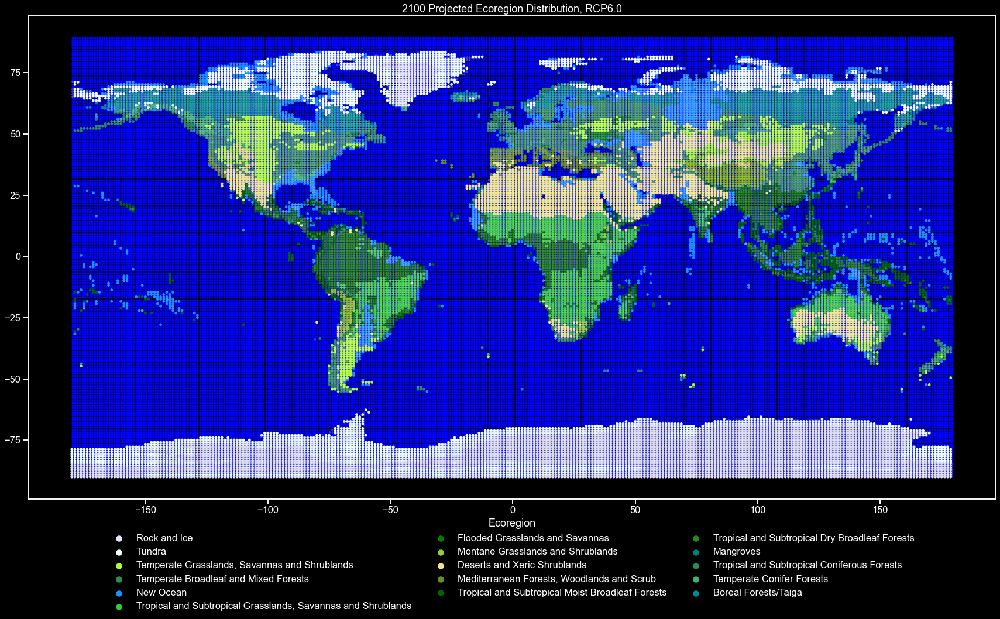

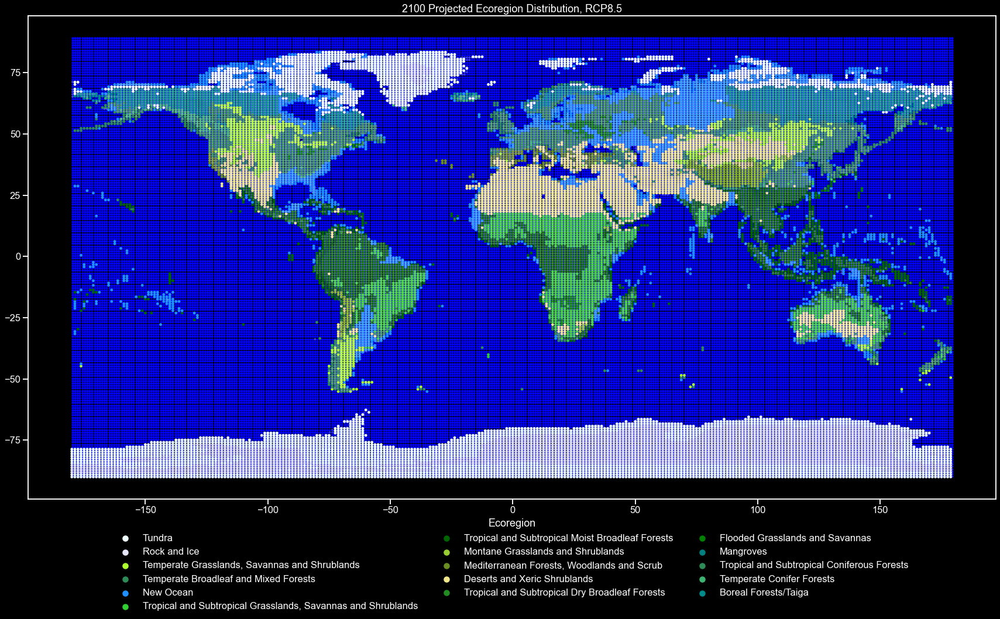

In [84]:
predGeo = gpd.GeoDataFrame(p_2_6[-1],geometry=pX8_5[0].geometry)
plotMap(predGeo[0],predGeo.geometry,Ageo,ocean_coords,ecoCMAP,2100,'RCP2.6')
predGeo = gpd.GeoDataFrame(p4_5_SLR[-1],geometry=pX8_5[0].geometry)
plotMap(predGeo[0],predGeo.geometry,Ageo,ocean_coords,ecoCMAP,2100,'RCP4.5')
predGeo = gpd.GeoDataFrame(p6_0_SLR[-1],geometry=pX8_5[0].geometry)
plotMap(predGeo[0],predGeo.geometry,Ageo,ocean_coords,ecoCMAP,2100,'RCP6.0')
predGeo = gpd.GeoDataFrame(p8_5_SLR[-1],geometry=pX8_5[0].geometry)
plotMap(predGeo[0],predGeo.geometry,Ageo,ocean_coords,ecoCMAP,2100,'RCP8.5')